In [1]:
import os, glob, csv, pickle

import numpy as np

import matplotlib.pyplot as plt
import matplotlib as mpl

from scipy.stats import rankdata
from scipy.special import binom
from scipy.spatial.distance import sqeuclidean

In [12]:
# Load Scenarios (load, solar, wind) of a given day
def _load_scenarios(path_to_data):
    # Load csv avoiding errors in the headers
    def __read_csv_file(file_name):
        with open(file_name) as _file:
            rows_ = []
            for row in csv.reader(_file, delimiter = ','):
                row = np.asarray(row[2:])[:, np.newaxis]
                rows_.append(row)
        rows_.pop(0)
        return np.concatenate(rows_, axis = 1).T
    # Load a load, solar or wind file
    def __load_dataset(path_to_data, source):
        y_ac_all_ = []
        y_fc_all_ = []
        Y_sc_all_ = []
        names_    = []
        # Loop over found files in the directory
        for file_ in os.listdir(path_to_data + source):

            # Read .csv file using csv
            Y_ = __read_csv_file(path_to_data + source + file_)
            
            # Split Data in .csv per variable of interest
            y_ac_ = Y_[0, :].astype(np.float_)
            y_fc_ = Y_[1, :].astype(np.float_)
            Y_sc_ = Y_[2:, :].astype(np.float_).T
            
            # Append Scenario
            y_ac_all_.append(y_ac_[:, np.newaxis])
            y_fc_all_.append(y_fc_[:, np.newaxis])
            Y_sc_all_.append(Y_sc_[..., np.newaxis])
            names_.append(file_[:-4].replace("_", " ") )
        # Return All Senarios for all Assets in Matrix form
        return np.concatenate(y_ac_all_, axis = 1), np.concatenate(y_fc_all_, axis = 1), np.concatenate(Y_sc_all_, axis = 2), names_
    
    L_ac_, L_fc_, L_sc_, L_names_ = __load_dataset(path_to_data, source = r'/load/')
    S_ac_, S_fc_, S_sc_, S_names_ = __load_dataset(path_to_data, source = r'/solar/')
    W_ac_, W_fc_, W_sc_, W_names_ = __load_dataset(path_to_data, source = r'/wind/')
    return [L_ac_, L_fc_, L_sc_, L_names_], [S_ac_, S_fc_, S_sc_, S_names_], [W_ac_, W_fc_, W_sc_, W_names_]




# Type of Assets
sources_ = ['Load', 'Solar', 'Wind']

# This is the path to data (stract inside Sim* files)
path_to_data = r'/Users/Guille/Desktop/extreme_scenarios/data/'

# Find All Simulations per Dates/Folders
files_ = glob.glob(path_to_data + r'Sim*')
print(files_)
# Load Simulation
Sim_ = _load_scenarios(files_[1])
print(Sim_[0][0].shape, Sim_[0][1].shape, Sim_[0][2].shape)
print(Sim_[1][0].shape, Sim_[1][1].shape, Sim_[1][2].shape)
print(Sim_[2][0].shape, Sim_[2][1].shape, Sim_[2][2].shape)

['/Users/Guille/Desktop/extreme_scenarios/data/SimDat_20180722', '/Users/Guille/Desktop/extreme_scenarios/data/SimDat_20181126', '/Users/Guille/Desktop/extreme_scenarios/data/SimDat_20180613', '/Users/Guille/Desktop/extreme_scenarios/data/SimDat_20180702', '/Users/Guille/Desktop/extreme_scenarios/data/SimDat_20180718', '/Users/Guille/Desktop/extreme_scenarios/data/SimDat_20180911']
(24, 8) (24, 8) (24, 1000, 8)
(24, 226) (24, 226) (24, 1000, 226)
(24, 264) (24, 264) (24, 1000, 264)


In [31]:
# Load fPCA features (load, solar, wind) of a given day
def _load_fPCA(path_to_data):
    # Load csv avoiding errors in the headers
    def __read_pkl_file(file_name):
        with open(file_name) as _file:
            rows_ = []
            for row in csv.reader(_file, delimiter = ','):
                row = np.asarray(row[2:])[:, np.newaxis]
                rows_.append(row)
        rows_.pop(0)
        return np.concatenate(rows_, axis = 1).T
    # Load a load, solar or wind file
    def __load_dataset(path_to_data, source):
        y_ac_all_ = []
        y_fc_all_ = []
        Y_sc_all_ = []
        names_    = []
        # Loop over found files in the directory
        for file_ in os.listdir(path_to_data + source):

            # Read .csv file using csv
            Y_ = __read_csv_file(path_to_data + source + file_)
            
            # Split Data in .csv per variable of interest
            y_ac_ = Y_[0, :].astype(np.float_)
            y_fc_ = Y_[1, :].astype(np.float_)
            Y_sc_ = Y_[2:, :].astype(np.float_).T
            
            # Append Scenario
            y_ac_all_.append(y_ac_[:, np.newaxis])
            y_fc_all_.append(y_fc_[:, np.newaxis])
            Y_sc_all_.append(Y_sc_[..., np.newaxis])
            names_.append(file_[:-4].replace("_", " ") )
        # Return All Senarios for all Assets in Matrix form
        #return np.concatenate(y_ac_all_, axis = 1), np.concatenate(y_fc_all_, axis = 1), np.concatenate(Y_sc_all_, axis = 2), names_
    print(path_to_data)
    source = r'/fPCA/solar/'
    for file_name in os.listdir(path_to_data + source):
        data_ = pickle.load(open(path_to_data + source + file_name,'rb'))
        mu_  = np.array(data_[0])
        Phi_ = data_[1]
        Xi_  = data_[2]
        print(file_name, mu_.shape, Phi_.shape, Xi_.shape)

    #L_mu_, L_phi_, L_xi_, L_names_ = __load_dataset(path_to_data, source = r'/fPCA/load/')
    #S_ac_, S_fc_, S_sc_, S_names_ = __load_dataset(path_to_data, source = r'/solar/')
    #W_ac_, W_fc_, W_sc_, W_names_ = __load_dataset(path_to_data, source = r'/wind/')
    return 

fPCA_ = _load_fPCA(files_[0])


/Users/Guille/Desktop/extreme_scenarios/data/SimDat_20180722
Charbray_Solar.pkl (24,) (24, 5) (1000, 5)
Pitts_Dudik_Solar.pkl (24,) (24, 6) (1000, 6)
HOVEY.pkl (24,) (24, 6) (1000, 6)
Pflugerville_2_Solar.pkl (24,) (24, 5) (1000, 5)
Opal_Solar.pkl (24,) (24, 6) (1000, 6)
Markum_Solar.pkl (24,) (24, 6) (1000, 6)
solar436.pkl (24,) (24, 7) (1000, 7)
Timberwolf_POI_A.pkl (24,) (24, 6) (1000, 6)
Trevino_Solar.pkl (24,) (24, 5) (1000, 5)
solar437.pkl (24,) (24, 7) (1000, 7)
Danish_Fields_III.pkl (24,) (24, 7) (1000, 7)
Flatland_Solar.pkl (24,) (24, 6) (1000, 6)
Texas_Solar_Nova.pkl (24,) (24, 6) (1000, 6)
Impact_Solar.pkl (24,) (24, 7) (1000, 7)
Sun_Valley_2.pkl (24,) (24, 7) (1000, 7)
Holstein_Solar.pkl (24,) (24, 6) (1000, 6)
Rayos_Del_Sol.pkl (24,) (24, 5) (1000, 5)
Queen_Solar.pkl (24,) (24, 6) (1000, 6)
Frye_Solar.pkl (24,) (24, 6) (1000, 6)
Bestla_Solar.pkl (24,) (24, 6) (1000, 6)
solar3.pkl (24,) (24, 8) (1000, 8)
solar435.pkl (24,) (24, 7) (1000, 7)
Dawn_Solar.pkl (24,) (24, 6) (100

# Load data and all nececessary functions

Load data from all available files in the directory saved in $path_to_data. Load all funtions necessaries to run the cells in this notebook.

In [59]:
# Load all datasets (load, solar, wind) of a given day
def _load_all_datasets(path_to_data):
    # Load csv avoiding errors in the headers
    def __read_csv_file(file_name):
        with open(file_name) as _file:
            rows_ = []
            for row in csv.reader(_file, delimiter = ','):
                row = np.asarray(row[2:])[:, np.newaxis]
                rows_.append(row)
        rows_.pop(0)
        return np.concatenate(rows_, axis = 1).T
    # Load a load, solar or wind file
    def __load_dataset(path_to_data, source):
        y_ac_all_ = []
        y_fc_all_ = []
        Y_sc_all_ = []
        names_    = []
        # Loop over found files in the directory
        for file_ in os.listdir(path_to_data + source):

            # Read .csv file using csv
            Y_ = __read_csv_file(path_to_data + source + file_)
            
            # Split Data in .csv per variable of interest
            y_ac_ = Y_[0, :].astype(np.float_)
            y_fc_ = Y_[1, :].astype(np.float_)
            Y_sc_ = Y_[2:, :].astype(np.float_).T
            
            # Append Scenario
            y_ac_all_.append(y_ac_[:, np.newaxis])
            y_fc_all_.append(y_fc_[:, np.newaxis])
            Y_sc_all_.append(Y_sc_[..., np.newaxis])
            names_.append(file_[:-4].replace("_", " ") )
        # Return All Senarios for all Assets in Matrix form
        return np.concatenate(y_ac_all_, axis = 1), np.concatenate(y_fc_all_, axis = 1), np.concatenate(Y_sc_all_, axis = 2), names_
    
    L_ac_, L_fc_, L_sc_, L_names_ = __load_dataset(path_to_data, source = r'/load/')
    S_ac_, S_fc_, S_sc_, S_names_ = __load_dataset(path_to_data, source = r'/solar/')
    W_ac_, W_fc_, W_sc_, W_names_ = __load_dataset(path_to_data, source = r'/wind/')
    return [L_ac_, L_fc_, L_sc_, L_names_], [S_ac_, S_fc_, S_sc_, S_names_], [W_ac_, W_fc_, W_sc_, W_names_]


# Type of Assets
sources_ = ['Load', 'Solar', 'Wind']

# This is the path to data (stract inside Sim* files)
path_to_data = r'/Users/Guille/Desktop/extreme_scenarios/data/'

# Find All Simulations per Dates/Folders
files_ = glob.glob(path_to_data + r'Sim*')

# Functional Envolep for Day-ahead Forecast (Hyperparameters Validation)

Validation of the functional envelop hyperparameters for a given conficence interval. The functional depth ranking used to define the envelop is Modified Band Depth. The functional envelop is defined using the maximum and minimum point-wise value in each time interval. The hypeparameter in the cross-validation define the optimal number of functions given a desired the confidence interval.

In [ ]:

# Compute Functional Envelop
def _functional_envelop(Y_, rank_, alpha):
    N_hours, N_scenarios = Y_.shape
    # Number of Functions within Functional Interval
    N_prime = N_scenarios - int(N_scenarios*alpha)
    #print(N_prime)
    Y_prime_    = Y_[:, rank_[:N_prime]]
    rank_prime_ = rank_[:N_prime]
    
    # Compute Functional Interval Stats   
    f_upper_ = np.max(Y_prime_, axis = 1)
    f_lower_ = np.min(Y_prime_, axis = 1)
    return f_upper_, f_lower_

# Compute Functional Envelop and the predictive mean
def _functional_envelop_predictive(Y_, rank_, alpha):
    N_hours, N_scenarios = Y_.shape
    # Number of Functions within Functional Interval
    N_prime = N_scenarios - int(N_scenarios*alpha)
    #print(N_prime)
    Y_prime_    = Y_[:, rank_[:N_prime]]
    rank_prime_ = rank_[:N_prime]
    
    # Compute Functional Interval Stats   
    f_mean_  = np.mean(Y_prime_, axis = 1)
    f_upper_ = np.max(Y_prime_, axis = 1)
    f_lower_ = np.min(Y_prime_, axis = 1)
    return f_mean_, f_upper_, f_lower_

# Modified Band Depth
def _MBD(Y_):
    N_hours, N_scenarios = Y_.shape

    rank_ = rankdata(Y_, method = 'average', axis = 1)
    down_ = rank_ - 1. 
    up_   = N_scenarios - rank_

    mbd_      = (np.sum(down_ * up_, axis = 0)/(N_scenarios + N_hours - 1))/binom(N_scenarios, 2)
    mbd_rank_ = np.argsort(mbd_)

    return mbd_, mbd_rank_

# Rank function using inverse Euclidian distance functional-knn
def _inv_distance(y_, Y_):
    d_ = np.zeros((Y_.shape[1]))
    for i in range(Y_.shape[1]):
        d_[i] = sqeuclidean(y_, Y_[:, i])
    d_ = 1./d_
    return d_/d_.sum()


# Empirical Density Function
def _EDF(y_):
    n = y_.shape[0]
    z_ = np.zeros((n,))
    for j in range(n,):
        z_[j] = (y_ < y_[j]).sum()
    return z_/n

# Root Mean Square Error
def _RMSE(y_, y_hat_):
    return np.sqrt((np.mean((y_ - y_hat_)**2)))

In [20]:
# Compute Winkler Score
def _Winkler_score(f_ac_, f_lower_, f_upper_, gamma):
    # Penalice when a sample is outside the interval
    def __penalty(y, l, u, gamma):
        d = u - l
        if y < l:
            return d + (2.*(l - y)/gamma)
        if (l <= y) & (y <= u):
            return d
        if y > u:
            return d + (2.*(y - u)/gamma)
        
    D = f_ac_.shape[-1]
    W = 0.
    # Compute Winkler Score for each time stamp
    for i in range(D):
        W += __penalty(f_ac_[i], f_lower_[i], f_upper_[i], gamma)
    return W

# Cross-Validate alpha for a given gamma
def _find_optimal_alpha(Y_, y_, ranking_, alphas_, gammas_):
    
    # Initializa variables
    N_alphas = len(alphas_)
    N_gammas = len(gammas_)

    # Initializa storage variable
    scores_ = np.zeros((N_alphas, N_gammas))
    
    # Loop over possible alphas
    for i in range(N_alphas):
        for j in range(N_gammas):
            # Get alpha
            alpha = alphas_[i]
            gamma = gammas_[j]
            # Get upper and lower bound
            f_upper_, f_lower_ = _functional_envelop(Y_, ranking_, alpha)
            # Get Winkler Score of the confidence interval
            scores_[i, j] = _Winkler_score(y_, f_lower_, f_upper_, gamma)
    
    return scores_
    # Find optimal alpha for each confidence interval
    #return [alphas_[i] for i in np.argmin(scores_, axis = 0)]

# Initialize hyperparameters
gammas_ = [.05, .1, .15, .20, .25, .3, .35]
alphas_ = np.linspace(.51, .999, 99)
print(alphas_)

for i_source in range(3):
    print(i_source)
    
    all_scores_ = []

    # Load data in files
    for i_day in range(len(files_) - 1): 
        file = files_[i_day]
        print(file)

        # Load Simulation
        Sim_ = _load_all_datasets(file)

        # Get number of assest in the i-th source
        N_assets = Sim_[i_source][0].shape[1]
        N_alphas = len(alphas_)
        N_gammas = len(gammas_)

        # Intitiliza storave variables
        scores_ = np.zeros((N_assets, N_alphas, N_gammas))

        # Get Alpha for each gamma for each asset
        for i_asset in range(N_assets):

            # Get Scenarios and actuals
            y_ac_ = Sim_[i_source][0][:, i_asset]
            Y_sc_ = Sim_[i_source][2][:, :, i_asset]

            # Rank scenarios using modified band depth notion
            mbd_, mbd_rank_ = _MBD(Y_sc_)

            # Find optimal alpha (No. of functions) to for the confidece interval gamma = (1 - p)
            scores_[i_asset, ...] = _find_optimal_alpha(Y_sc_, y_ac_, mbd_rank_[::-1], alphas_, gammas_)

        # Save optimal alphas for data in this file
        all_scores_.append(scores_[np.newaxis, ...])

    # Get all scores in matrix form
    all_scores_ = np.concatenate(all_scores_, axis = 0)
    # Sum Winkler scores for each training day
    all_scores_prime_ = np.sum(all_scores_, axis = 0)

    # Find the optimal alpha for each asset at each confince interval
    opt_alphas_ = np.zeros((N_assets, N_gammas))
    for i_asset in range(N_assets):
        for i_gamma in range(N_gammas):
            opt_alphas_[i_asset, i_gamma] = alphas_[np.argmin(all_scores_prime_[i_asset, :, i_gamma])]
    print(opt_alphas_.shape)

    # Save optimal parameters results
    with open(path_to_data + r"opt-ci-hyperparameters_source-{}.pkl".format(i_source), 'wb') as _f:
        pickle.dump(opt_alphas_, _f, protocol = pickle.HIGHEST_PROTOCOL)

[0.51       0.5149898  0.51997959 0.52496939 0.52995918 0.53494898
 0.53993878 0.54492857 0.54991837 0.55490816 0.55989796 0.56488776
 0.56987755 0.57486735 0.57985714 0.58484694 0.58983673 0.59482653
 0.59981633 0.60480612 0.60979592 0.61478571 0.61977551 0.62476531
 0.6297551  0.6347449  0.63973469 0.64472449 0.64971429 0.65470408
 0.65969388 0.66468367 0.66967347 0.67466327 0.67965306 0.68464286
 0.68963265 0.69462245 0.69961224 0.70460204 0.70959184 0.71458163
 0.71957143 0.72456122 0.72955102 0.73454082 0.73953061 0.74452041
 0.7495102  0.7545     0.7594898  0.76447959 0.76946939 0.77445918
 0.77944898 0.78443878 0.78942857 0.79441837 0.79940816 0.80439796
 0.80938776 0.81437755 0.81936735 0.82435714 0.82934694 0.83433673
 0.83932653 0.84431633 0.84930612 0.85429592 0.85928571 0.86427551
 0.86926531 0.8742551  0.8792449  0.88423469 0.88922449 0.89421429
 0.89920408 0.90419388 0.90918367 0.91417347 0.91916327 0.92415306
 0.92914286 0.93413265 0.93912245 0.94411224 0.94910204 0.9540

### Demostration of the resulting day-ahead envelope

Notice that running the folliwing cell does not requiere to run the hyperparameters validation first. The validation results were saved, and next are loaded for the follwoing cells in the notebook. The test is performed using a day that was not including in the validation.

In [55]:
i_source = 0

# Load Simulation
Sim_ = _load_all_datasets(files_[-1])

# Get Scenarios, forecast and actuals
y_ac_    = Sim_[i_source][0]
y_fc_    = Sim_[i_source][1]
Y_sc_    = Sim_[i_source][2]
y_names_ = Sim_[i_source][3]
#print(y_ac_.shape, y_fc_.shape, Y_sc_.shape, len(y_names_))

# Load optimal parameters results
with open(path_to_data + r"opt-ci-hyperparameters_source-{}.pkl".format(i_source), 'rb') as _f:
    opt_alphas_ = pickle.load(_f)
    
print(opt_alphas_.shape)

gammas_ = [.05, .1, .15, .20, .25, .3, .35]
alphas_ = np.linspace(.51, .999, 99)

(8, 7)


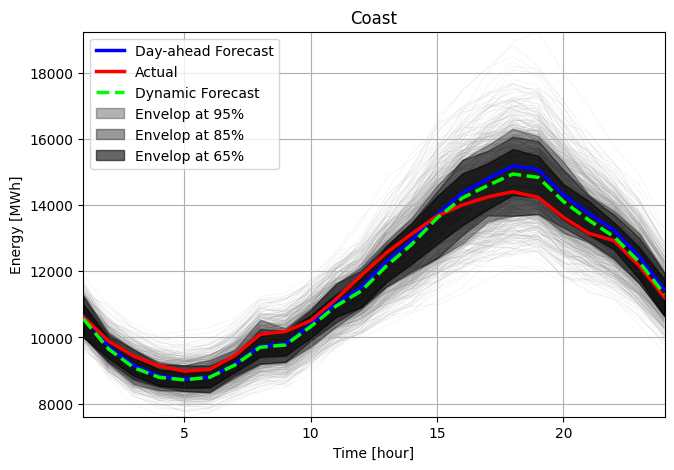

In [58]:
i_asset = 1

N_assets, N_gammas = opt_alphas_.shape
N_hours = y_ac_.shape[0]

x_ = np.linspace(1, N_hours, N_hours) # Rank scenarios using modified band depth notion
mbd_, mbd_rank_ = _MBD(Y_sc_[..., i_asset])

# Plot day-ahead forecasting envelop
plt.figure(figsize = (7.5, 5))
plt.title(y_names_[i_asset])
plt.plot(x_, Y_sc_[...,i_asset], color = 'gray', linewidth = .1, zorder = 1, alpha = .5)
plt.plot(x_, y_fc_[...,i_asset], color = 'b', linewidth = 2.5, zorder = 9, label = 'Day-ahead Forecast')
plt.plot(x_, y_ac_[...,i_asset], color = 'r', linewidth = 2.5, zorder = 9, label = 'Actual')
plt.xlim(1, 24)
plt.ylim(Y_sc_[..., i_asset].min(), Y_sc_[..., i_asset].max())

f_mean_, f_upper_, f_lower_ = _functional_envelop_predictive(Y_sc_[..., i_asset], mbd_rank_[::-1], opt_alphas_[i_asset, i_gamma])

plt.plot(x_, f_mean_, '--', color = 'lime', linewidth = 2.5, zorder = 9, label = 'Dynamic Forecast')
    
for i_gamma in [0, 2, 6]:
    #print(i_gamma, gammas_[i_gamma], opt_alphas_[i_asset, i_gamma], 1000. - int(1000.*opt_alphas_[i_asset, i_gamma]))


    f_upper_, f_lower_ = _functional_envelop(Y_sc_[..., i_asset], mbd_rank_[::-1], opt_alphas_[i_asset, i_gamma])

    plt.fill_between(x_, f_lower_, f_upper_, color = 'k', alpha = gammas_[i_gamma] + .25, zorder = i_gamma + 2, 
                     label = r'Envelop at {}%'.format(int(100.*(1. - gammas_[i_gamma]))))

plt.ylabel('Energy [MWh]')
plt.xlabel('Time [hour]')
plt.legend()
plt.grid()
plt.show()

# Dynamic Update of the Functional Envolep for during Day-ahead operation (Hyperparameter Validation)

Dyanamic update of day-ahead forecast applying the method proposed by Elia et al [1]. This methid requieres the validation of the alpha hyperparameter to select the number of scenarios used to define the envelop. The metric to evalute the quality of the envelope at differnt confidence intervals is the Winkler score [2].

[1] Elías, A., Jiménez, R. and Shang, H.L., 2022. On projection methods for functional time series forecasting. Journal of Multivariate Analysis, 189, p.104890.

[2] Winkler, R.L., Munoz, J., Cervera, J.L., Bernardo, J.M., Blattenberger, G., Kadane, J.B., Lindley, D.V., Murphy, A.H., Oliver, R.M. and Ríos-Insua, D., 1996. Scoring rules and the evaluation of probabilities. Test, 5(1), pp.1-60.

## Functional K-Nearest Neighbors (f-kNN): inverse Euclidian distance

The f-kNN uses a metric to measure a distance between the functions in a set. The metric implemented is inverse Euclidian distance. This means a function in the set is weighted more when is closer to the observaation.

In [13]:
# Compute Winkler Score
def _Winkler_score(f_ac_, f_lower_, f_upper_, gamma):
    # Penalice when a sample is outside the interval
    def __penalty(y, l, u, gamma):
        d = u - l
        if y < l:
            return d + (2.*(l - y)/gamma)
        if (l <= y) & (y <= u):
            return d
        if y > u:
            return d + (2.*(y - u)/gamma)
        
    D = f_ac_.shape[-1]
    W = 0.
    # Compute Winkler Score for each time stamp
    for i in range(D):
        W += __penalty(f_ac_[i], f_lower_[i], f_upper_[i], gamma)
    return W

# Cross-Validate alpha for a given gamma
def _find_optimal_alpha(Y_, y_, ranking_, alphas_, gammas_):
    
    # Initializa variables
    N_alphas = len(alphas_)
    N_gammas = len(gammas_)

    # Initializa storage variable
    scores_ = np.zeros((N_alphas, N_gammas))
    
    # Loop over possible alphas
    for i in range(N_alphas):
        for j in range(N_gammas):
            # Get alpha
            alpha = alphas_[i]
            gamma = gammas_[j]
            # Get upper and lower bound
            f_upper_, f_lower_ = _functional_envelop(Y_, ranking_, alpha)
            # Get Winkler Score of the confidence interval
            scores_[i, j] = _Winkler_score(y_, f_lower_, f_upper_, gamma)
    
    return scores_
    # Find optimal alpha for each confidence interval
    #return [alphas_[i] for i in np.argmin(scores_, axis = 0)]

# Initialize hyperparameters
gammas_ = [.05, .1, .15, .20, .25, .3, .35]
alphas_ = np.linspace(.51, .999, 99)
print(alphas_)

for i_source in range(3):
    print(i_source)

    all_scores_ = []

    # Load data in files
    for i_day in range(len(files_) - 1): 
        file = files_[i_day]
        print(file)

        # Load Simulation
        Sim_ = _load_all_datasets(file)

        # Get number of assest in the i-th source
        N_hours, N_assets = Sim_[i_source][0].shape
        N_alphas = len(alphas_)
        N_gammas = len(gammas_)
        #print(N_hours, N_assets, N_alphas, N_gammas)

        # Intitiliza storave variables
        scores_ = np.zeros((N_assets, N_hours - 1, N_alphas, N_gammas))

        # Get Alpha for each gamma for each asset
        for i_asset in range(N_assets):

            # Get Scenarios and actuals
            y_ac_ = Sim_[i_source][0][:, i_asset]
            Y_sc_ = Sim_[i_source][2][:, :, i_asset]

            # Get Alpha for each gamma for each observed hour
            for i_hour in range(1, N_hours):

                # Rank data using only seen samples
                y_ac_prime_ = y_ac_[:i_hour]
                Y_sc_prime_ = Y_sc_[:i_hour, :]

                # Rank scenarios using inverse euclidian distance
                d_      = _inv_distance(y_ac_prime_, Y_sc_prime_)
                d_rank_ = np.argsort(d_)

                # Find optimal alpha (No. of functions) to for the confidece interval gamma = (1 - p)
                scores_[i_asset, i_hour - 1, ...] = _find_optimal_alpha(Y_sc_, y_ac_, d_rank_[::-1], alphas_, gammas_)

        # Save optimal alphas for data in this file
        all_scores_.append(scores_[np.newaxis, ...])

    # Get all scores in matrix form
    all_scores_prime_ = np.concatenate(all_scores_, axis = 0)

    # Sum Winkler scores for each training day
    all_scores_prime_prime_ = np.sum(all_scores_prime_, axis = 0)
    print(all_scores_prime_prime_.shape)

    # Find the optimal alpha for each asset at each confince interval
    opt_alphas_ = np.zeros((N_assets, N_hours - 1, N_gammas))
    for i_asset in range(N_assets):
        for i_hour in range(N_hours - 1):
            for i_gamma in range(N_gammas):
                opt_alphas_[i_asset, i_hour, i_gamma] = alphas_[np.argmin(all_scores_prime_prime_[i_asset, i_hour, :, i_gamma])]
    print(opt_alphas_.shape)

    # Save optimal parameters results
    with open(path_to_data + r"opt-ci-inv-dynamic-updating-hyperparameters_source-{}.pkl".format(i_source), 'wb') as _f:
        pickle.dump(opt_alphas_, _f, protocol = pickle.HIGHEST_PROTOCOL)

[0.51       0.5149898  0.51997959 0.52496939 0.52995918 0.53494898
 0.53993878 0.54492857 0.54991837 0.55490816 0.55989796 0.56488776
 0.56987755 0.57486735 0.57985714 0.58484694 0.58983673 0.59482653
 0.59981633 0.60480612 0.60979592 0.61478571 0.61977551 0.62476531
 0.6297551  0.6347449  0.63973469 0.64472449 0.64971429 0.65470408
 0.65969388 0.66468367 0.66967347 0.67466327 0.67965306 0.68464286
 0.68963265 0.69462245 0.69961224 0.70460204 0.70959184 0.71458163
 0.71957143 0.72456122 0.72955102 0.73454082 0.73953061 0.74452041
 0.7495102  0.7545     0.7594898  0.76447959 0.76946939 0.77445918
 0.77944898 0.78443878 0.78942857 0.79441837 0.79940816 0.80439796
 0.80938776 0.81437755 0.81936735 0.82435714 0.82934694 0.83433673
 0.83932653 0.84431633 0.84930612 0.85429592 0.85928571 0.86427551
 0.86926531 0.8742551  0.8792449  0.88423469 0.88922449 0.89421429
 0.89920408 0.90419388 0.90918367 0.91417347 0.91916327 0.92415306
 0.92914286 0.93413265 0.93912245 0.94411224 0.94910204 0.9540

/var/folders/0c/ffx2kgyn7xq4krqrpsv67l3m0000gn/T/ipykernel_26083/2338003279.py:74: RuntimeWarning: divide by zero encountered in true_divide
  d_ = 1./d_
/var/folders/0c/ffx2kgyn7xq4krqrpsv67l3m0000gn/T/ipykernel_26083/2338003279.py:75: RuntimeWarning: invalid value encountered in true_divide
  return d_/d_.sum()


/Users/Guille/Desktop/extreme_scenarios/data/SimDat_20181126
/Users/Guille/Desktop/extreme_scenarios/data/SimDat_20180613
/Users/Guille/Desktop/extreme_scenarios/data/SimDat_20180702
/Users/Guille/Desktop/extreme_scenarios/data/SimDat_20180718
(226, 23, 99, 7)
(226, 23, 7)
2
/Users/Guille/Desktop/extreme_scenarios/data/SimDat_20180722
/Users/Guille/Desktop/extreme_scenarios/data/SimDat_20181126
/Users/Guille/Desktop/extreme_scenarios/data/SimDat_20180613
/Users/Guille/Desktop/extreme_scenarios/data/SimDat_20180702
/Users/Guille/Desktop/extreme_scenarios/data/SimDat_20180718
(264, 23, 99, 7)
(264, 23, 7)


### Demostration of the dynamic updating with inverse Euclidian distance

Similar to preview notebook cells, running the folliwing cell does not requiere to run the hyperparameters validation first in the dynamic updating. The test is performed using a day that was not including in the validation. The dynamic updating of the envelope is implemented applying the inverse distance in the f-kNN method.

In [18]:
i_source = 0

# Load Simulation
Sim_ = _load_all_datasets(files_[-1])

# Get Scenarios, forecast and actuals
y_ac_    = Sim_[i_source][0]
y_fc_    = Sim_[i_source][1]
Y_sc_    = Sim_[i_source][2]
y_names_ = Sim_[i_source][3]
#print(y_ac_.shape, y_fc_.shape, Y_sc_.shape, len(y_names_))

# Load optimal parameters results
with open(path_to_data + r"opt-ci-inv-dynamic-updating-hyperparameters_source-{}.pkl".format(i_source), 'rb') as _f:
    opt_alphas_ = pickle.load(_f)
    
print(opt_alphas_.shape)

gammas_ = [.05, .1, .15, .20, .25, .3, .35]
alphas_ = np.linspace(.51, .999, 99)

(8, 23, 7)


0 0.05 0.9790408163265305 21.0
2 0.15 0.9840306122448979 16.0
6 0.35 0.9940102040816327 6.0


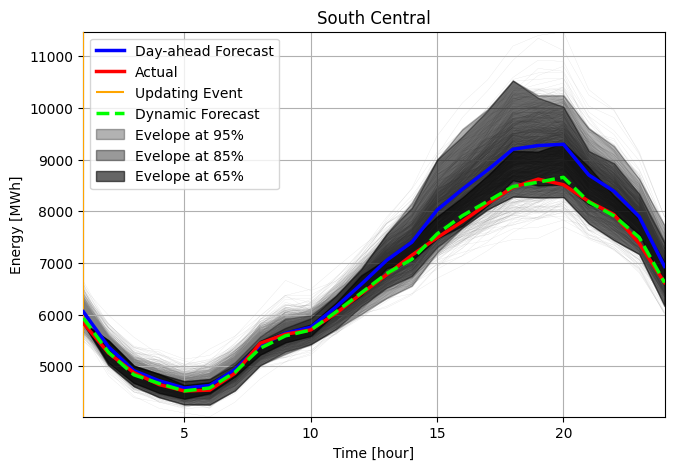

0 0.05 0.9890204081632653 11.0
2 0.15 0.9890204081632653 11.0
6 0.35 0.9940102040816327 6.0


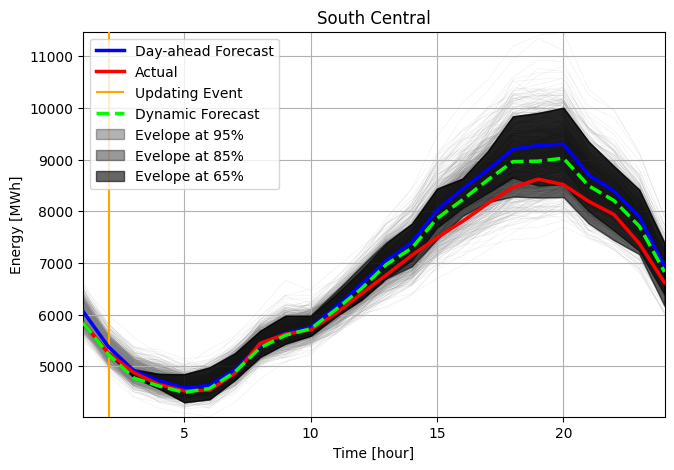

0 0.05 0.9840306122448979 16.0
2 0.15 0.9890204081632653 11.0
6 0.35 0.9940102040816327 6.0


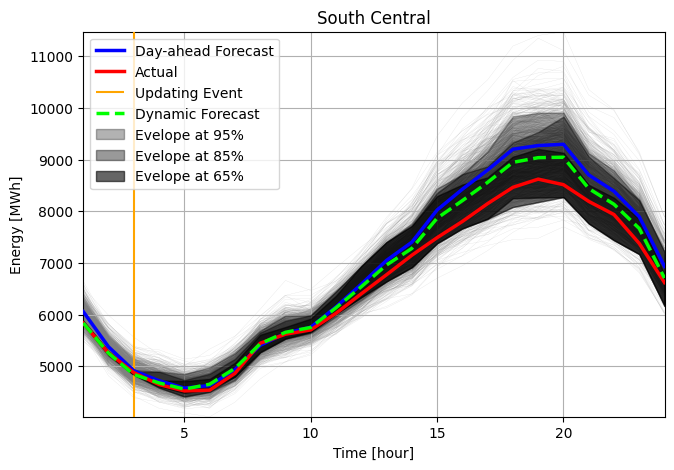

0 0.05 0.9740510204081632 26.0
2 0.15 0.9940102040816327 6.0
6 0.35 0.9940102040816327 6.0


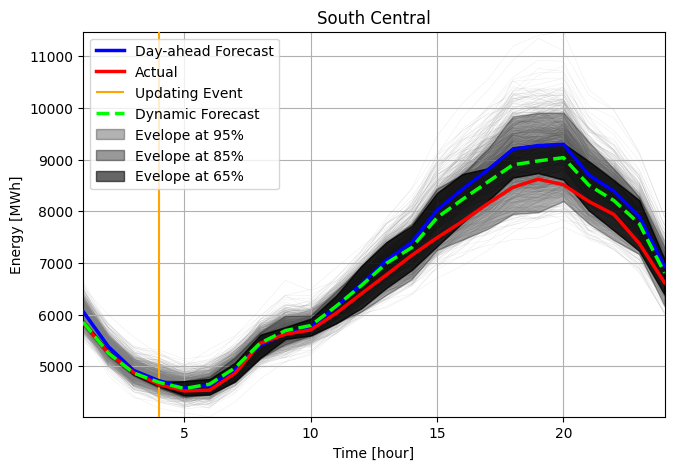

0 0.05 0.9890204081632653 11.0
2 0.15 0.9890204081632653 11.0
6 0.35 0.9940102040816327 6.0


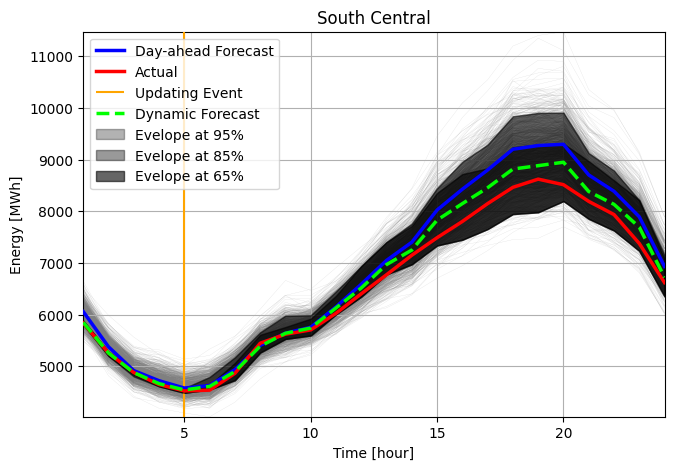

0 0.05 0.9840306122448979 16.0
2 0.15 0.9840306122448979 16.0
6 0.35 0.9940102040816327 6.0


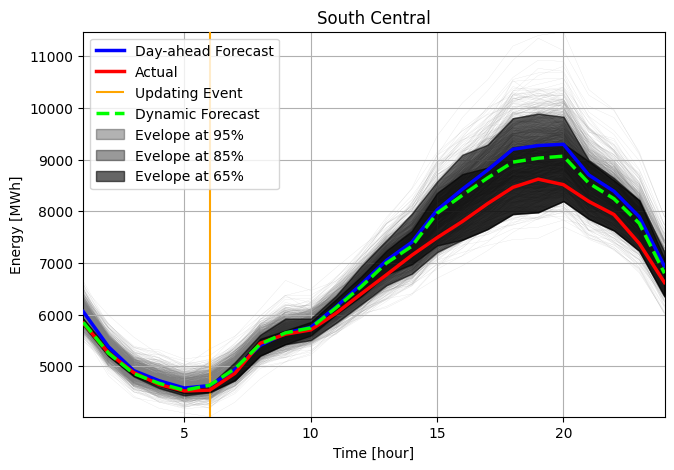

0 0.05 0.9840306122448979 16.0
2 0.15 0.9840306122448979 16.0
6 0.35 0.9940102040816327 6.0


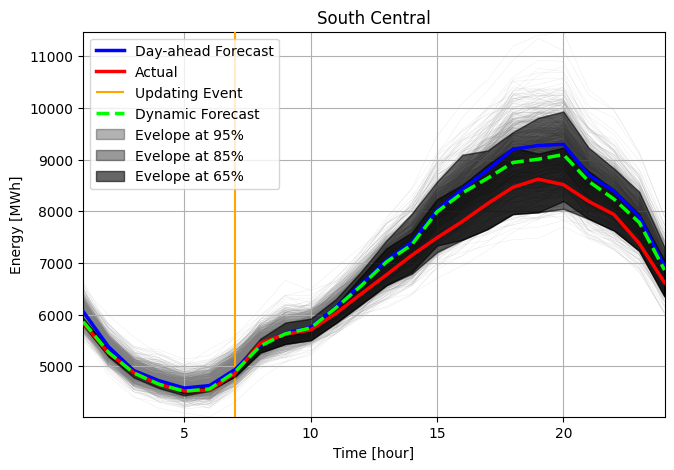

0 0.05 0.9640714285714285 36.0
2 0.15 0.9940102040816327 6.0
6 0.35 0.9940102040816327 6.0


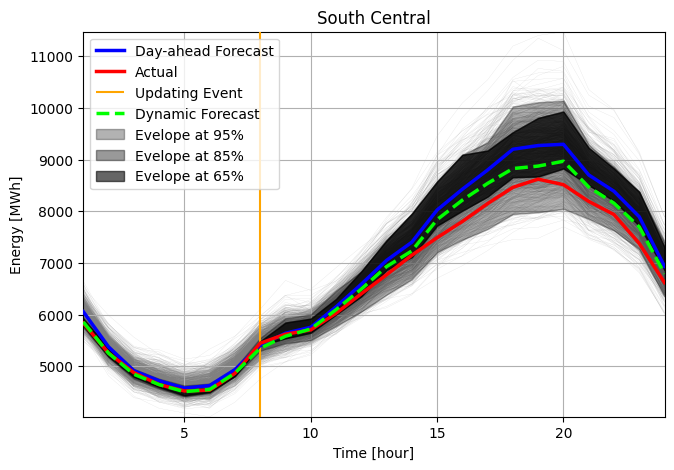

0 0.05 0.9540918367346938 46.0
2 0.15 0.9940102040816327 6.0
6 0.35 0.9940102040816327 6.0


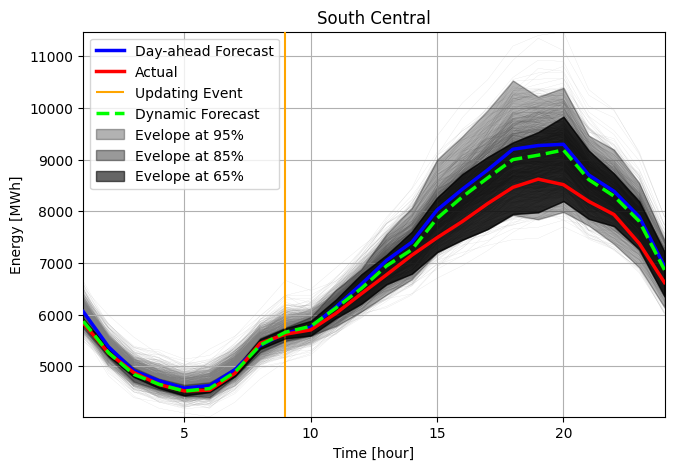

0 0.05 0.9690612244897958 31.0
2 0.15 0.9890204081632653 11.0
6 0.35 0.9940102040816327 6.0


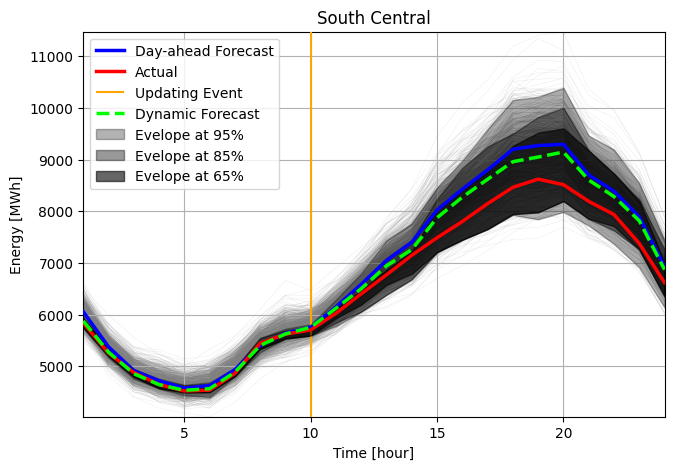

0 0.05 0.9790408163265305 21.0
2 0.15 0.9890204081632653 11.0
6 0.35 0.9940102040816327 6.0


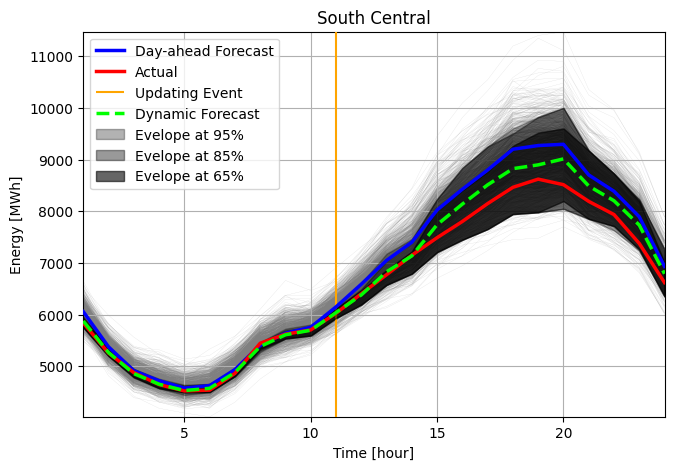

0 0.05 0.9391224489795917 61.0
2 0.15 0.9890204081632653 11.0
6 0.35 0.9940102040816327 6.0


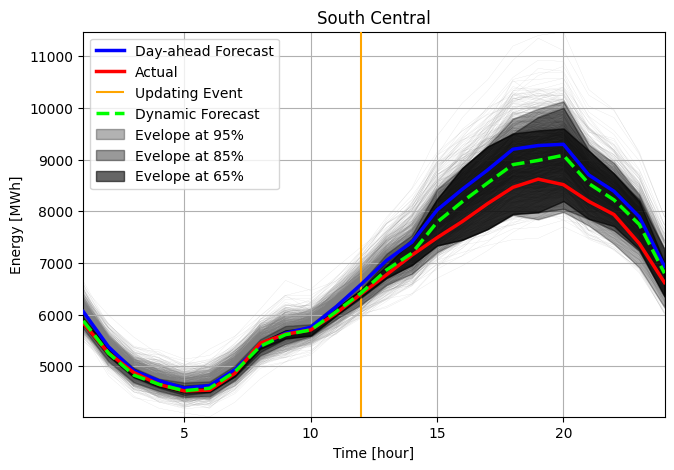

0 0.05 0.9890204081632653 11.0
2 0.15 0.9890204081632653 11.0
6 0.35 0.9940102040816327 6.0


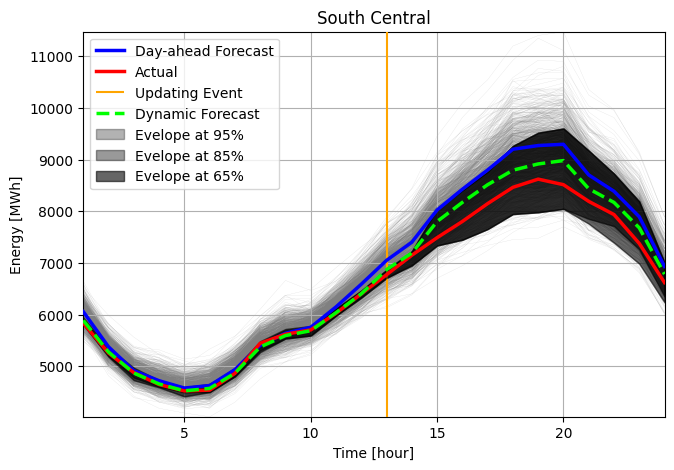

0 0.05 0.9740510204081632 26.0
2 0.15 0.9890204081632653 11.0
6 0.35 0.9940102040816327 6.0


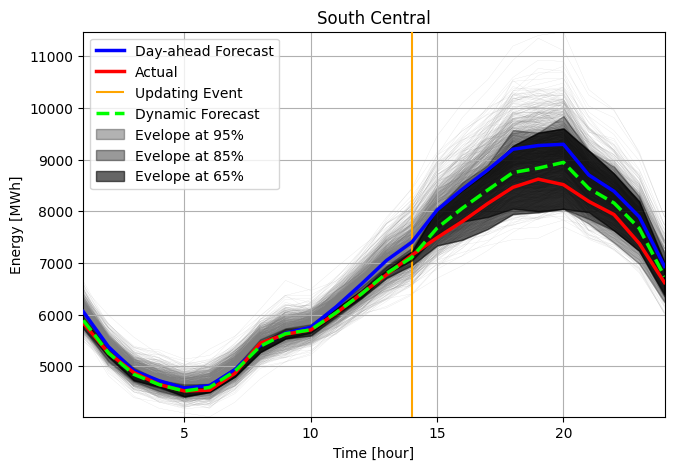

0 0.05 0.9690612244897958 31.0
2 0.15 0.9940102040816327 6.0
6 0.35 0.9940102040816327 6.0


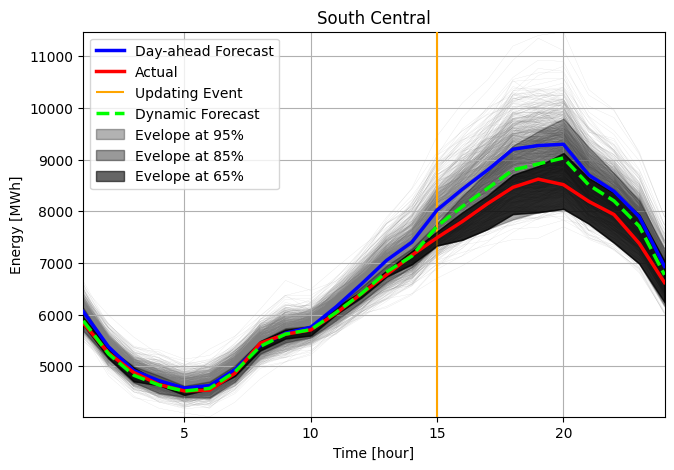

0 0.05 0.9491020408163264 51.0
2 0.15 0.9840306122448979 16.0
6 0.35 0.9940102040816327 6.0


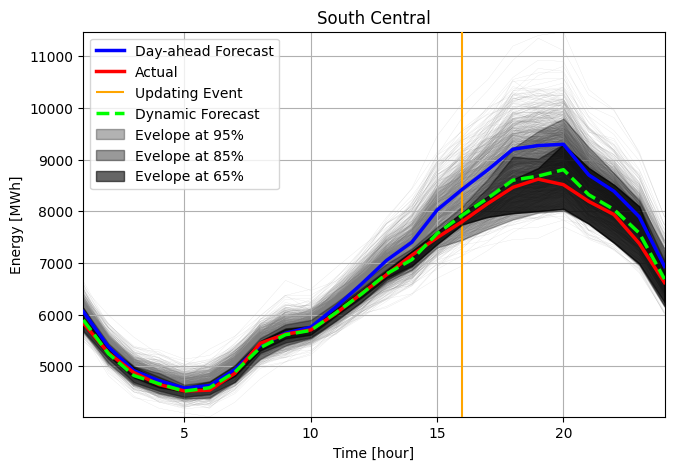

0 0.05 0.9491020408163264 51.0
2 0.15 0.9840306122448979 16.0
6 0.35 0.9940102040816327 6.0


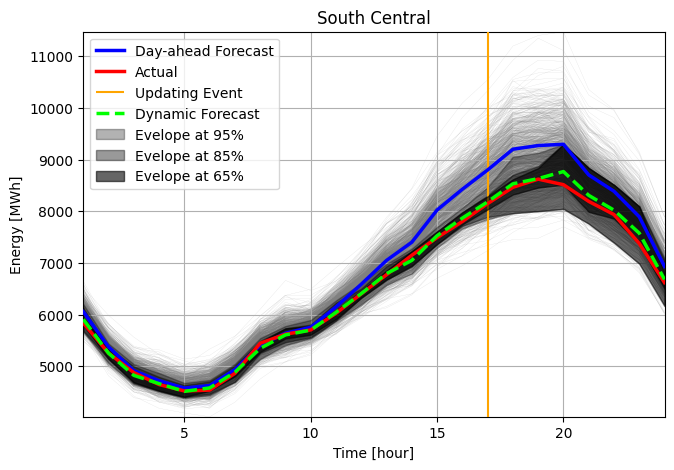

0 0.05 0.914173469387755 86.0
2 0.15 0.9890204081632653 11.0
6 0.35 0.9940102040816327 6.0


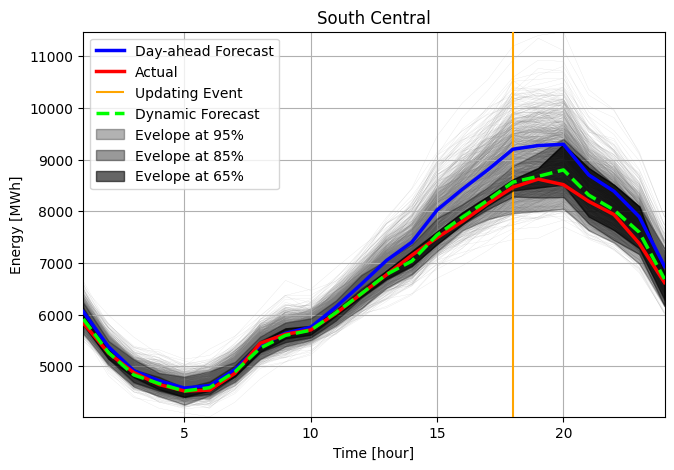

0 0.05 0.9091836734693877 91.0
2 0.15 0.9840306122448979 16.0
6 0.35 0.9940102040816327 6.0


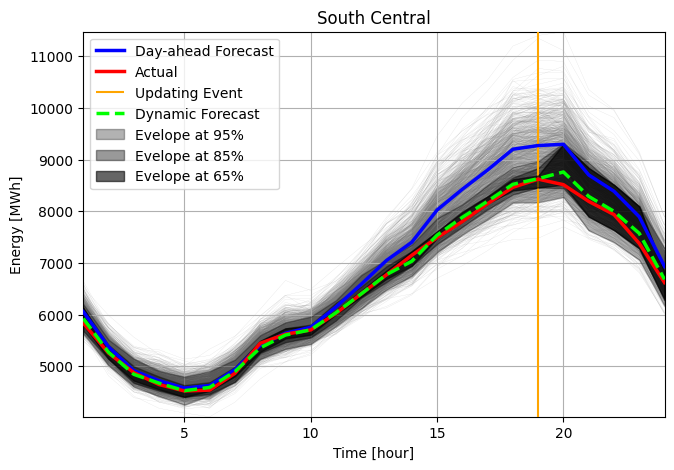

0 0.05 0.9590816326530611 41.0
2 0.15 0.9840306122448979 16.0
6 0.35 0.9940102040816327 6.0


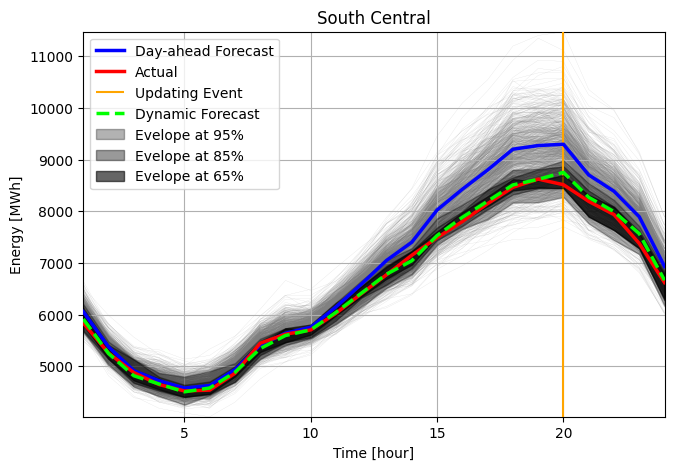

0 0.05 0.9790408163265305 21.0
2 0.15 0.9890204081632653 11.0
6 0.35 0.9940102040816327 6.0


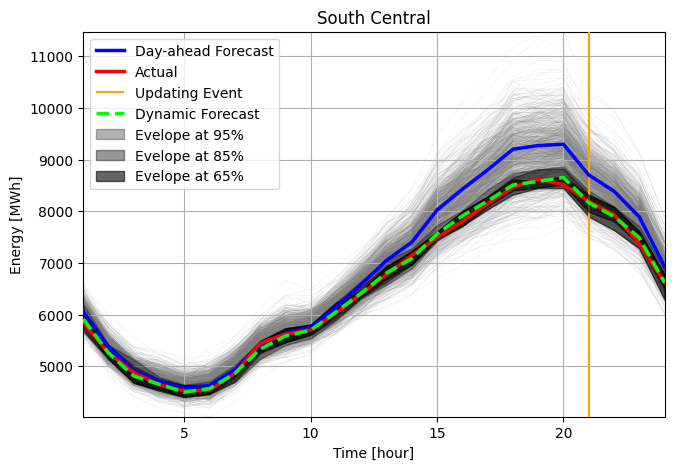

0 0.05 0.9840306122448979 16.0
2 0.15 0.9890204081632653 11.0
6 0.35 0.9940102040816327 6.0


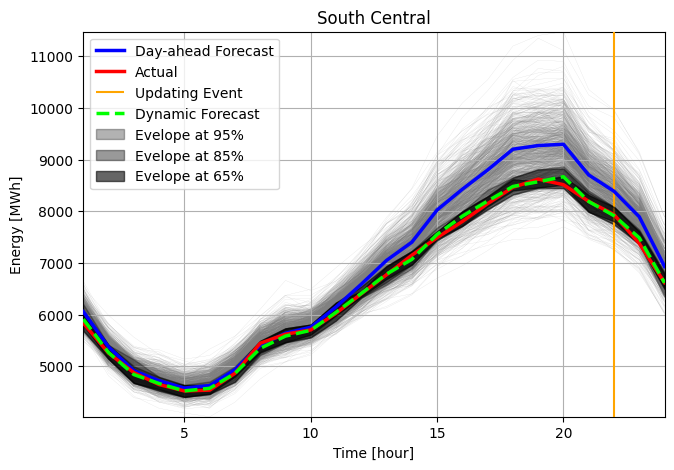

0 0.05 0.9840306122448979 16.0
2 0.15 0.9940102040816327 6.0
6 0.35 0.9940102040816327 6.0


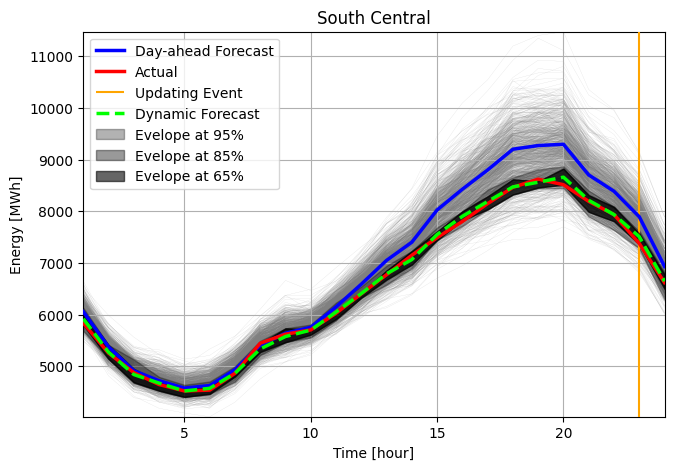

In [53]:
i_asset = 0

N_assets, _, N_gammas = opt_alphas_.shape
N_hours = y_ac_.shape[0]

x_ = np.linspace(1, N_hours, N_hours)

# Get Scenarios and actuals
y_ac_ = Sim_[i_source][0][:, i_asset]
y_fc_ = Sim_[i_source][1][:, i_asset]
Y_sc_ = Sim_[i_source][2][:, :, i_asset]
    
for i_hour in range(1, N_hours):
    
    # Rank data using only seen samples
    y_ac_prime_ = y_ac_[:i_hour]
    Y_sc_prime_ = Y_sc_[:i_hour, :]
            
    # Plot day-ahead forecasting envelop
    plt.figure(figsize = (7.5, 5))
    plt.title(y_names_[i_asset])
    plt.plot(x_, Y_sc_, color = 'gray', linewidth = .1, zorder = 1, alpha = .5)
    plt.plot(x_, y_fc_, color = 'b', linewidth = 2.5, zorder = 9, label = 'Day-ahead Forecast')
    plt.plot(x_, y_ac_, color = 'r', linewidth = 2.5, zorder = 9, label = 'Actual')
    plt.vlines(i_hour, Y_sc_.min(), Y_sc_.max(), color = 'orange', zorder = 5, label = 'Updating Event')
    
    plt.xlim(1, N_hours)
    plt.ylim(Y_sc_.min(), Y_sc_.max())
    
    f_mean_, _, _ = _functional_envelop_predictive(Y_sc_, d_rank_[::-1], opt_alphas_[i_asset, i_hour - 1, 0])
    plt.plot(x_, f_mean_, '--', color = 'lime', linewidth = 2.5, zorder = 9, label = 'Dynamic Forecast')
        
    for i_gamma in [0, 2, 6]:
        sigma = opt_sigmas_[i_asset, i_hour - 1, i_gamma]
        alpha = opt_alphas_[i_asset, i_hour - 1, i_gamma]
        print(i_gamma, gammas_[i_gamma], opt_alphas_[i_asset, i_hour - 1, i_gamma], 1000. - int(1000.*opt_alphas_[i_asset, i_hour - 1, i_gamma]))
            
        # Rank scenarios using modified band depth notion
        d_      = _inv_distance(y_ac_prime_, Y_sc_prime_)
        d_rank_ = np.argsort(d_)
        
        f_mean_, f_upper_, f_lower_ = _functional_envelop_predictive(Y_sc_, d_rank_[::-1], opt_alphas_[i_asset, i_hour - 1, i_gamma])
    
        plt.fill_between(x_, f_lower_, f_upper_, color = 'k', alpha = gammas_[i_gamma] + .25, zorder = i_gamma + 2, 
                         label = r'Evelope at {}%'.format(int(100.*(1. - gammas_[i_gamma]))))
    plt.ylabel('Energy [MWh]')
    plt.xlabel('Time [hour]')
    plt.legend()
    plt.grid()
    plt.show()

## Functional K-Nearest Neighbors (f-kNN): Exponential distance (Hyperparameters Validaiton)

The metric use to measure a distance is the expoential distance. This distance corresponds is equivalento a radial basis function with a single lengthscale hyperparameter. The validation of the lengthscale hyperparameter is included in the validation the following notebook cell. Notice that is not necessary to run this cell to visualize the results. The validated hyperparameters are saved and loaded for demostration puerposes.

In [15]:
# Compute Functional Envelop
def _functional_envelop(Y_, rank_, alpha):
    N_hours, N_scenarios = Y_.shape
    # Number of Functions within Functional Interval
    N_prime = N_scenarios - int(N_scenarios*alpha)
    #print(N_prime)
    Y_prime_    = Y_[:, rank_[:N_prime]]
    rank_prime_ = rank_[:N_prime]
    
    # Compute Functional Interval Stats   
    f_upper_ = np.max(Y_prime_, axis = 1)
    f_lower_ = np.min(Y_prime_, axis = 1)
    return f_upper_, f_lower_

# Compute Winkler Score
def _Winkler_score(f_ac_, f_lower_, f_upper_, gamma):
    # Penalice when a sample is outside the interval
    def __penalty(y, l, u, gamma):
        d = u - l
        if y < l:
            return d + (2.*(l - y)/gamma)
        if (l <= y) & (y <= u):
            return d
        if y > u:
            return d + (2.*(y - u)/gamma)
        
    D = f_ac_.shape[-1]
    W = 0.
    # Compute Winkler Score for each time stamp
    for i in range(D):
        W += __penalty(f_ac_[i], f_lower_[i], f_upper_[i], gamma)
    return W

# Rank function using exponential distance functional-knn
def _exp_distance(y_, Y_, sigma):
    d_ = np.zeros((Y_.shape[1]))
    for i in range(Y_.shape[1]):
        d_[i] = sqeuclidean(y_, Y_[:, i])
    d_ = np.exp(-d_/sigma)
    return d_/d_.sum()

# Cross-Validate alpha for a given gamma
def _find_optimal_alpha(Y_, y_, ranking_, alphas_, gammas_):
    
    # Initializa variables
    N_alphas = len(alphas_)
    N_gammas = len(gammas_)

    # Initializa storage variable
    scores_ = np.zeros((N_alphas, N_gammas))
    
    # Loop over possible alphas
    for i in range(N_alphas):
        for j in range(N_gammas):
            # Get alpha
            alpha = alphas_[i]
            gamma = gammas_[j]
            # Get upper and lower bound
            f_upper_, f_lower_ = _functional_envelop(Y_, ranking_, alpha)
            # Get Winkler Score of the confidence interval
            scores_[i, j] = _Winkler_score(y_, f_lower_, f_upper_, gamma)
    
    return scores_
    # Find optimal alpha for each confidence interval
    #return [alphas_[i] for i in np.argmin(scores_, axis = 0)]

i_source = 2

# Initialize hyperparameters
gammas_ = [.05, .1, .15, .20, .25, .3, .35]
alphas_ = np.linspace(.51, .999, 99)
sigmas_ = np.logspace(-7., 7., 25)
print(alphas_)
print(sigmas_)

all_scores_ = []

# Load data in files
for i_day in range(len(files_) - 1): 
    file = files_[i_day]
    print(file)

    # Load Simulation
    Sim_ = _load_all_datasets(file)

    # Get number of assest in the i-th source
    N_hours, N_assets = Sim_[i_source][0].shape
    N_alphas = len(alphas_)
    N_gammas = len(gammas_)
    N_sigmas = len(sigmas_)
    #print(N_hours, N_assets, N_sigmas, N_alphas, N_gammas)

    # Intitiliza storave variables
    scores_ = np.zeros((N_assets, N_hours - 1, N_sigmas, N_alphas, N_gammas))

    # Get Asset for each sigma for each gamma for each asset
    for i_asset in range(N_assets):

        # Get Scenarios and actuals
        y_ac_ = Sim_[i_source][0][:, i_asset]
        Y_sc_ = Sim_[i_source][2][:, :, i_asset]

        # Get Sigma for each Alpha for each gamma for each observed hour
        for i_sigma in range(N_sigmas):

            # Get alpha for each gamma for each observed hour
            for i_hour in range(1, N_hours):

                # Rank data using only seen samples
                y_ac_prime_ = y_ac_[:i_hour]
                Y_sc_prime_ = Y_sc_[:i_hour, :]

                # Rank scenarios using inverse euclidian distance                
                d_      = _exp_distance(y_ac_prime_, Y_sc_prime_, sigma = sigmas_[i_sigma])
                d_rank_ = np.argsort(d_)

                # Find optimal alpha (No. of functions) to for the confidece interval gamma = (1 - p)
                scores_[i_asset, i_hour - 1, i_sigma, ...] = _find_optimal_alpha(Y_sc_, y_ac_, d_rank_[::-1], alphas_, gammas_)

    # Save optimal alphas for data in this file
    all_scores_.append(scores_[np.newaxis, ...])

# Get all scores in matrix form
all_scores_prime_ = np.concatenate(all_scores_, axis = 0)

# Sum Winkler scores for each training day
all_scores_prime_prime_ = np.sum(all_scores_prime_, axis = 0)

# Find the optimal alpha for each asset at each confince interval
opt_alphas_ = np.zeros((N_assets, N_hours - 1, N_gammas))
opt_sigmas_ = np.zeros((N_assets, N_hours - 1, N_gammas))

for i_asset in range(N_assets):
    for i_hour in range(N_hours - 1):
        for i_gamma in range(N_gammas):
            i_sigma_, i_alpha_ = np.where(all_scores_prime_prime_[i_asset, i_hour, :, :, i_gamma] == all_scores_prime_prime_[i_asset, i_hour, :, :, i_gamma].min())            
            opt_sigmas_[i_asset, i_hour, i_gamma] = sigmas_[i_sigma_[0]]
            opt_alphas_[i_asset, i_hour, i_gamma] = alphas_[i_alpha_[0]]

print(opt_sigmas_.shape, opt_alphas_.shape)

# Save optimal parameters results
with open(path_to_data + r"opt-ci-exp-dynamic-updating-hyperparameters_source-{}.pkl".format(i_source), 'wb') as _f:
    pickle.dump([opt_sigmas_, opt_alphas_], _f, protocol = pickle.HIGHEST_PROTOCOL)

[0.51       0.5149898  0.51997959 0.52496939 0.52995918 0.53494898
 0.53993878 0.54492857 0.54991837 0.55490816 0.55989796 0.56488776
 0.56987755 0.57486735 0.57985714 0.58484694 0.58983673 0.59482653
 0.59981633 0.60480612 0.60979592 0.61478571 0.61977551 0.62476531
 0.6297551  0.6347449  0.63973469 0.64472449 0.64971429 0.65470408
 0.65969388 0.66468367 0.66967347 0.67466327 0.67965306 0.68464286
 0.68963265 0.69462245 0.69961224 0.70460204 0.70959184 0.71458163
 0.71957143 0.72456122 0.72955102 0.73454082 0.73953061 0.74452041
 0.7495102  0.7545     0.7594898  0.76447959 0.76946939 0.77445918
 0.77944898 0.78443878 0.78942857 0.79441837 0.79940816 0.80439796
 0.80938776 0.81437755 0.81936735 0.82435714 0.82934694 0.83433673
 0.83932653 0.84431633 0.84930612 0.85429592 0.85928571 0.86427551
 0.86926531 0.8742551  0.8792449  0.88423469 0.88922449 0.89421429
 0.89920408 0.90419388 0.90918367 0.91417347 0.91916327 0.92415306
 0.92914286 0.93413265 0.93912245 0.94411224 0.94910204 0.9540

/var/folders/0c/ffx2kgyn7xq4krqrpsv67l3m0000gn/T/ipykernel_84844/4035706153.py:40: RuntimeWarning: invalid value encountered in true_divide
  return d_/d_.sum()


/Users/Guille/Desktop/extreme_scenarios/data/SimDat_20181126
/Users/Guille/Desktop/extreme_scenarios/data/SimDat_20180613
/Users/Guille/Desktop/extreme_scenarios/data/SimDat_20180702
/Users/Guille/Desktop/extreme_scenarios/data/SimDat_20180718
(264, 23, 7) (264, 23, 7)


### Demostration of the dynamic updating with exponetial distance

The test is performed using a day that was not including in the validation. The dynamic updating of the envelope is implemented applying the exponential distance in the f-knn method. This distance have a lenghtscale hyperparameters that also requieres validation

In [20]:
i_source = 0

# Load Simulation
Sim_ = _load_all_datasets(files_[-1])

# Get Scenarios, forecast and actuals
y_ac_    = Sim_[i_source][0]
y_fc_    = Sim_[i_source][1]
Y_sc_    = Sim_[i_source][2]
y_names_ = Sim_[i_source][3]
#print(y_ac_.shape, y_fc_.shape, Y_sc_.shape, len(y_names_))

# Load optimal parameters results
with open(path_to_data + r"opt-ci-exp-dynamic-updating-hyperparameters_source-{}.pkl".format(i_source), 'rb') as _f:
    opt_sigmas_, opt_alphas_ = pickle.load(_f)
    
print(opt_sigmas_.shape, opt_alphas_.shape)

alphas_ = np.linspace(.51, .999, 99)
sigmas_ = np.logspace(-7., 7., 25)

(8, 23, 7) (8, 23, 7)


0 0.05 0.9790408163265305 21.0
2 0.15 0.9840306122448979 16.0
6 0.35 0.9940102040816327 6.0


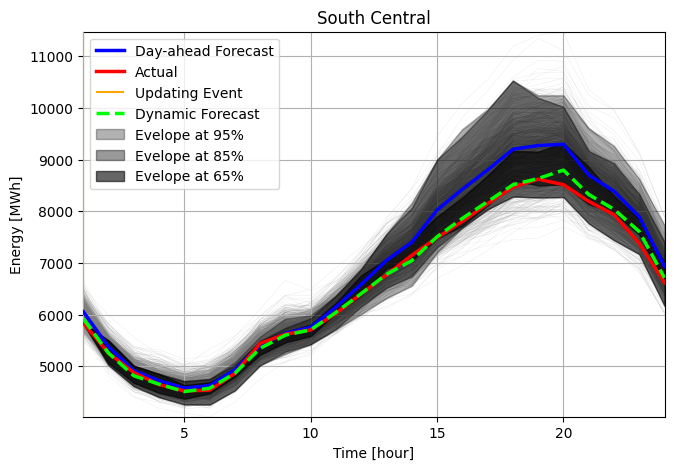

0 0.05 0.9890204081632653 11.0
2 0.15 0.9890204081632653 11.0
6 0.35 0.9940102040816327 6.0


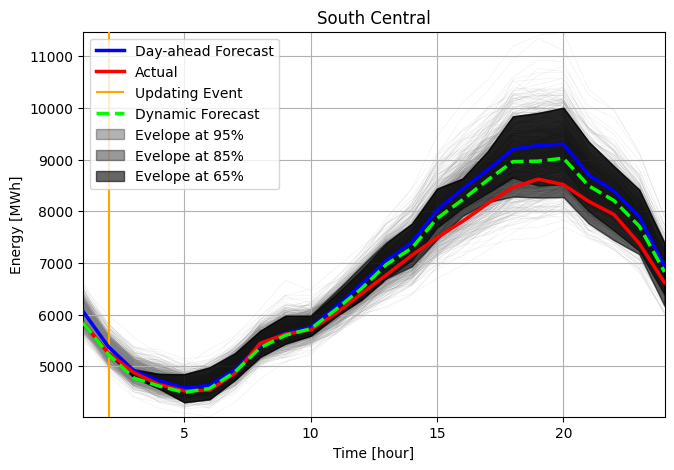

0 0.05 0.9840306122448979 16.0
2 0.15 0.9890204081632653 11.0
6 0.35 0.9940102040816327 6.0


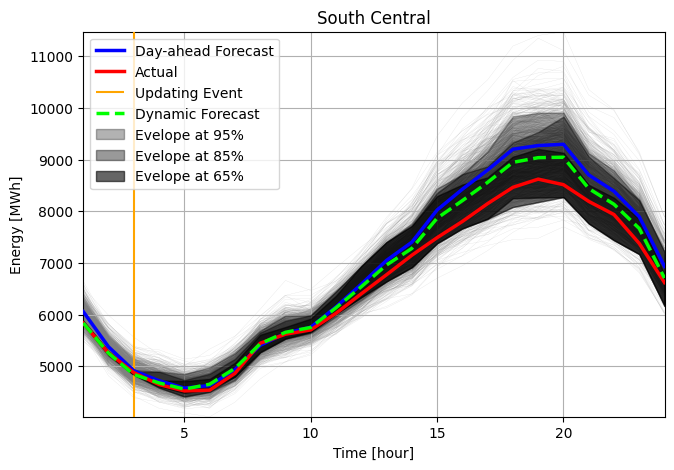

0 0.05 0.9740510204081632 26.0
2 0.15 0.9940102040816327 6.0
6 0.35 0.9940102040816327 6.0


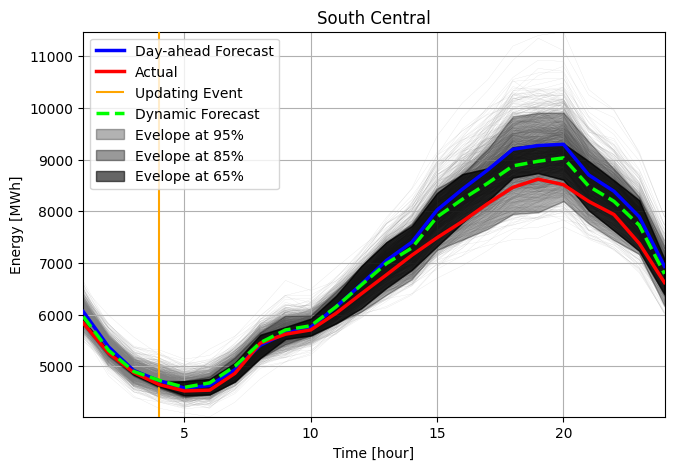

0 0.05 0.9890204081632653 11.0
2 0.15 0.9890204081632653 11.0
6 0.35 0.9940102040816327 6.0


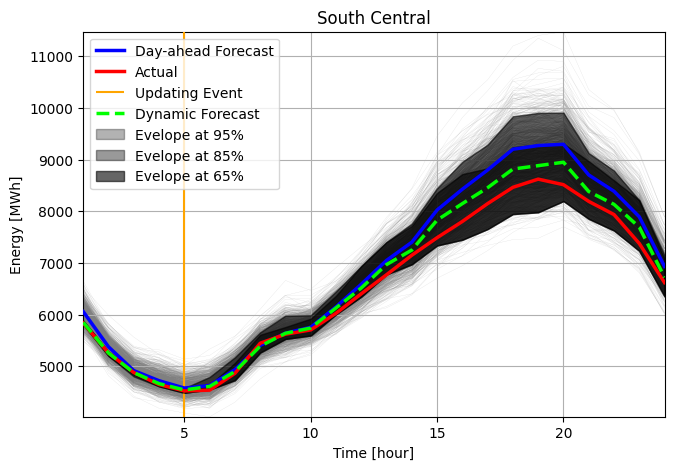

0 0.05 0.9840306122448979 16.0
2 0.15 0.9840306122448979 16.0
6 0.35 0.9940102040816327 6.0


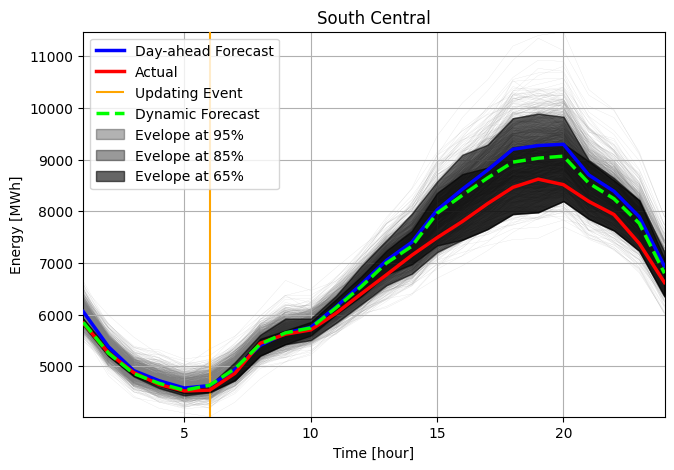

0 0.05 0.9840306122448979 16.0
2 0.15 0.9840306122448979 16.0
6 0.35 0.9940102040816327 6.0


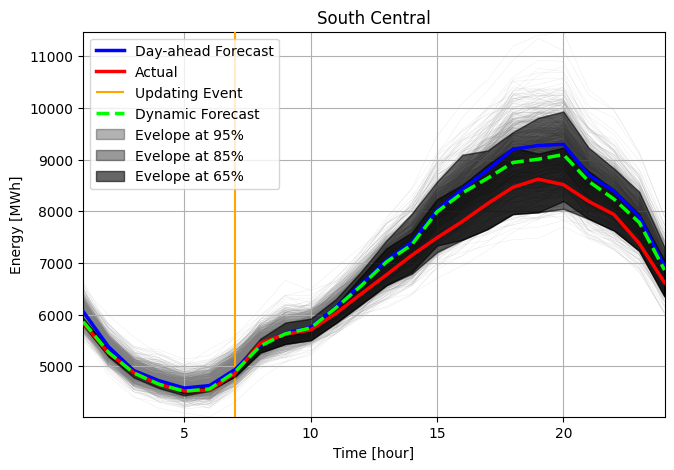

0 0.05 0.9640714285714285 36.0
2 0.15 0.9940102040816327 6.0
6 0.35 0.9940102040816327 6.0


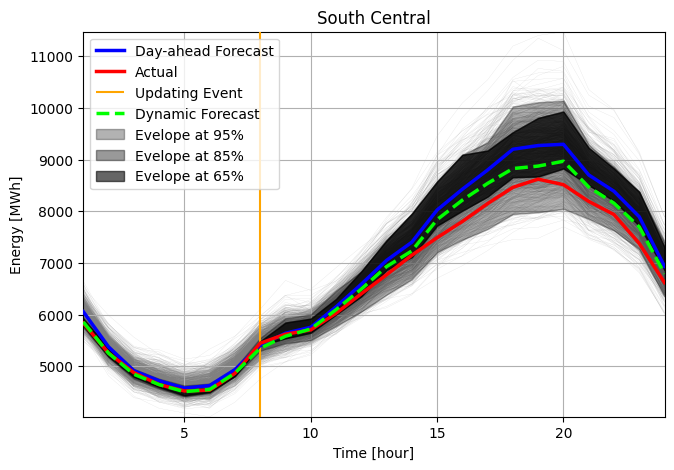

0 0.05 0.9540918367346938 46.0
2 0.15 0.9940102040816327 6.0
6 0.35 0.9940102040816327 6.0


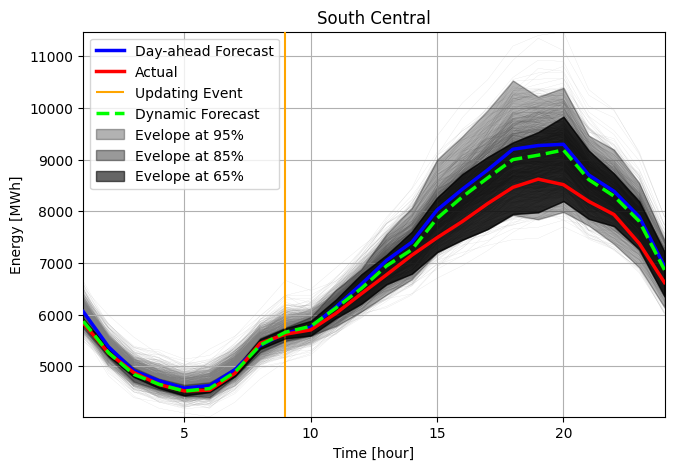

0 0.05 0.9690612244897958 31.0
2 0.15 0.9890204081632653 11.0
6 0.35 0.9940102040816327 6.0


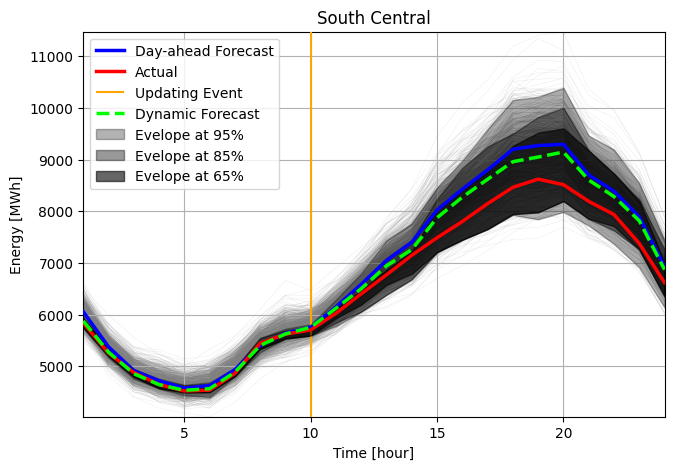

0 0.05 0.9790408163265305 21.0
2 0.15 0.9890204081632653 11.0
6 0.35 0.9940102040816327 6.0


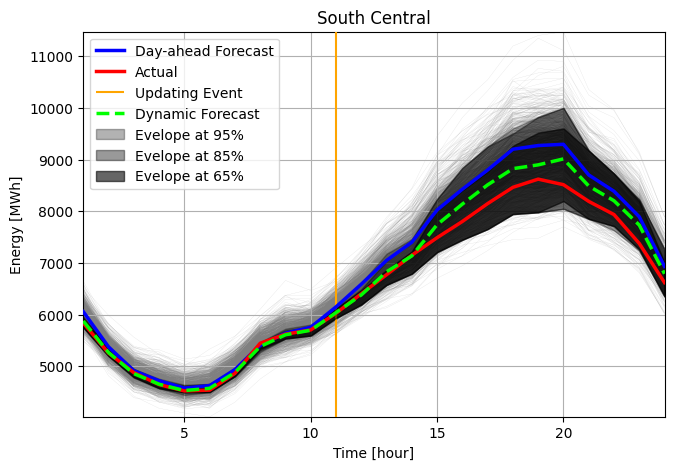

0 0.05 0.9391224489795917 61.0
2 0.15 0.9890204081632653 11.0
6 0.35 0.9940102040816327 6.0


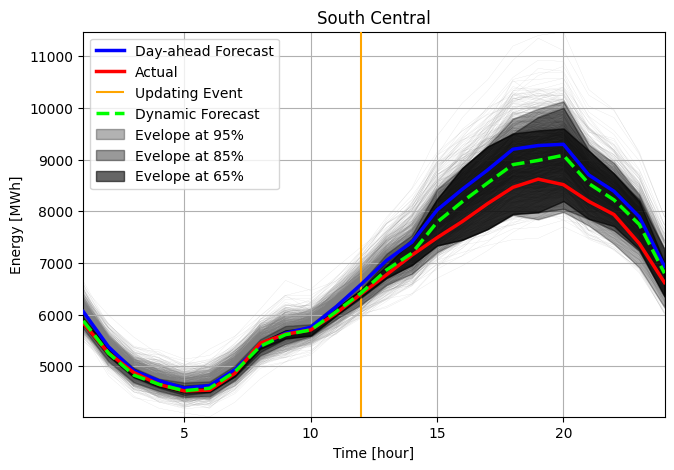

0 0.05 0.9890204081632653 11.0
2 0.15 0.9890204081632653 11.0
6 0.35 0.9940102040816327 6.0


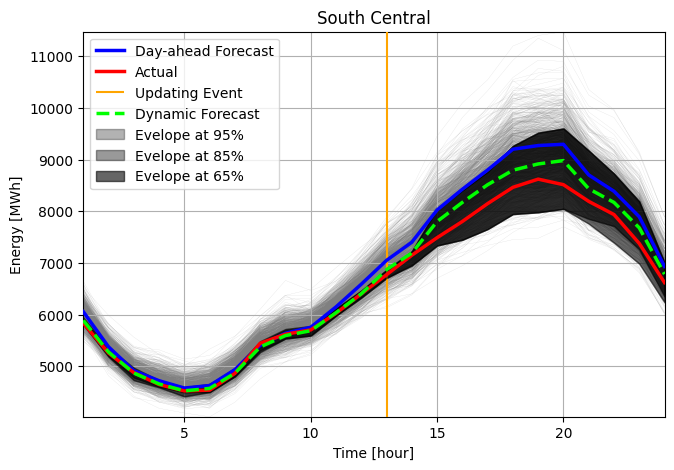

0 0.05 0.9740510204081632 26.0
2 0.15 0.9890204081632653 11.0
6 0.35 0.9940102040816327 6.0


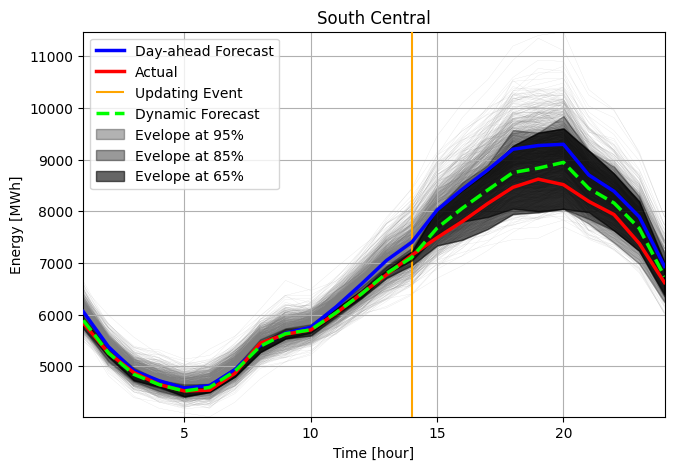

0 0.05 0.9690612244897958 31.0
2 0.15 0.9940102040816327 6.0
6 0.35 0.9940102040816327 6.0


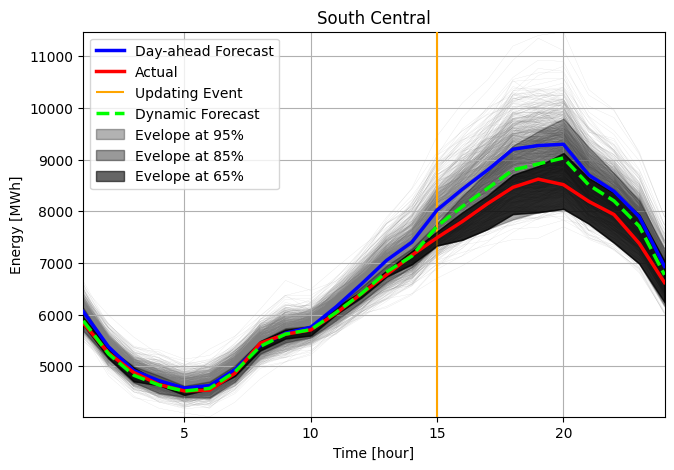

0 0.05 0.9491020408163264 51.0
2 0.15 0.9840306122448979 16.0
6 0.35 0.9940102040816327 6.0


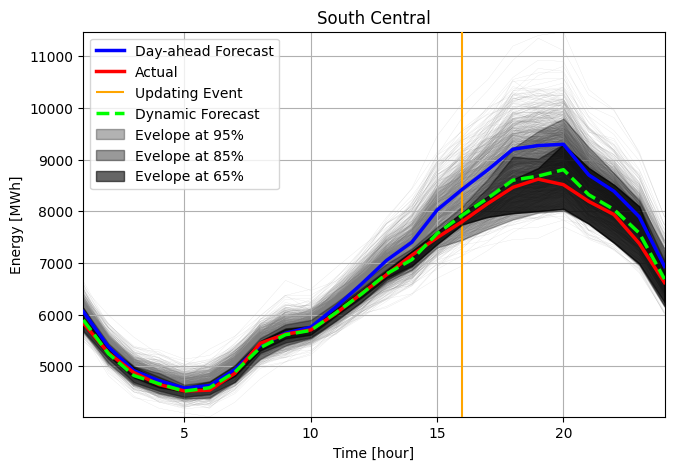

0 0.05 0.9491020408163264 51.0
2 0.15 0.9840306122448979 16.0
6 0.35 0.9940102040816327 6.0


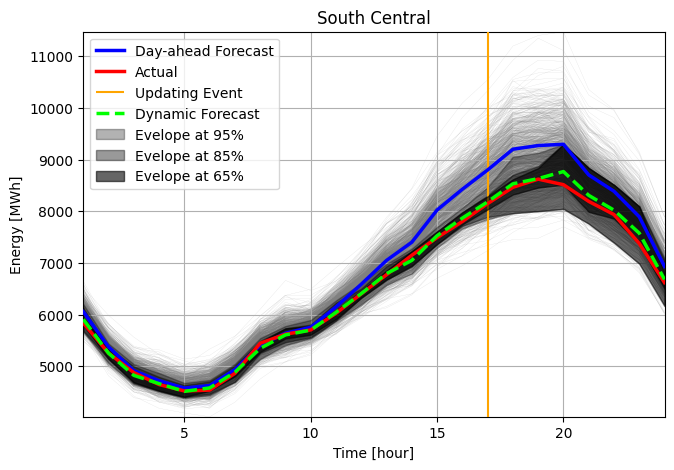

0 0.05 0.914173469387755 86.0
2 0.15 0.9890204081632653 11.0
6 0.35 0.9940102040816327 6.0


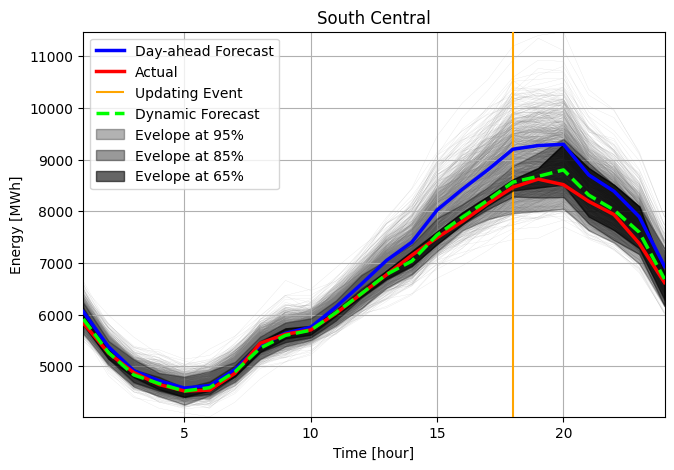

0 0.05 0.9091836734693877 91.0
2 0.15 0.9840306122448979 16.0
6 0.35 0.9940102040816327 6.0


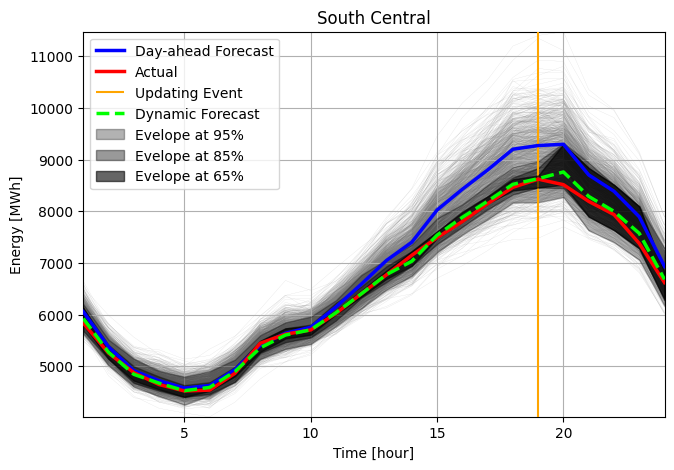

0 0.05 0.9590816326530611 41.0
2 0.15 0.9840306122448979 16.0
6 0.35 0.9940102040816327 6.0


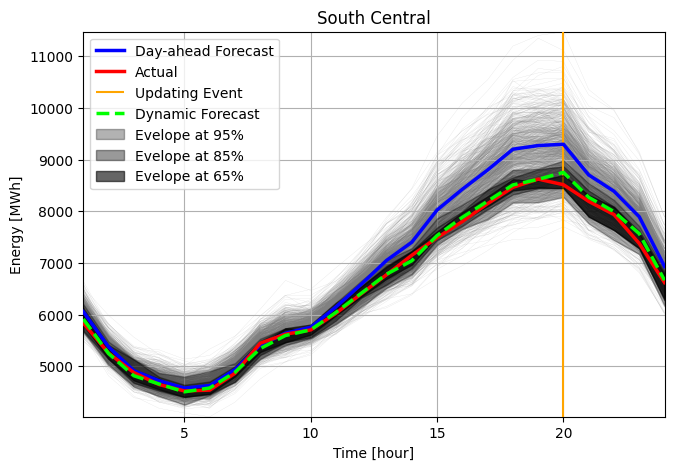

0 0.05 0.9790408163265305 21.0
2 0.15 0.9890204081632653 11.0
6 0.35 0.9940102040816327 6.0


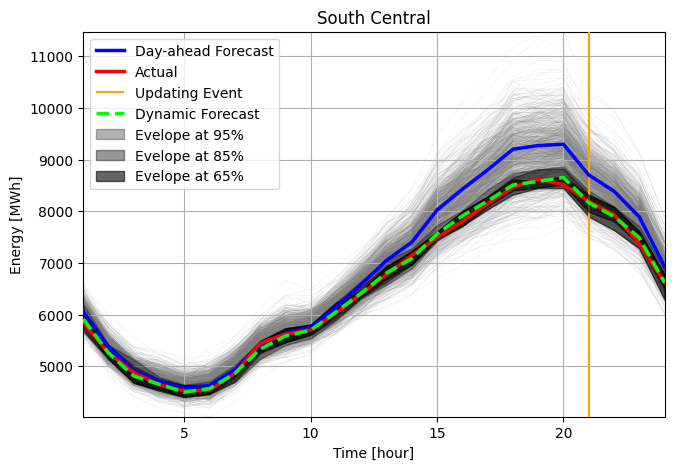

0 0.05 0.9840306122448979 16.0
2 0.15 0.9890204081632653 11.0
6 0.35 0.9940102040816327 6.0


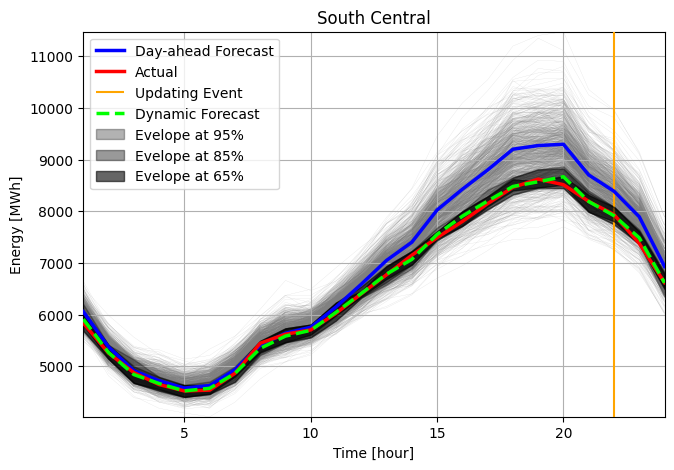

0 0.05 0.9840306122448979 16.0
2 0.15 0.9940102040816327 6.0
6 0.35 0.9940102040816327 6.0


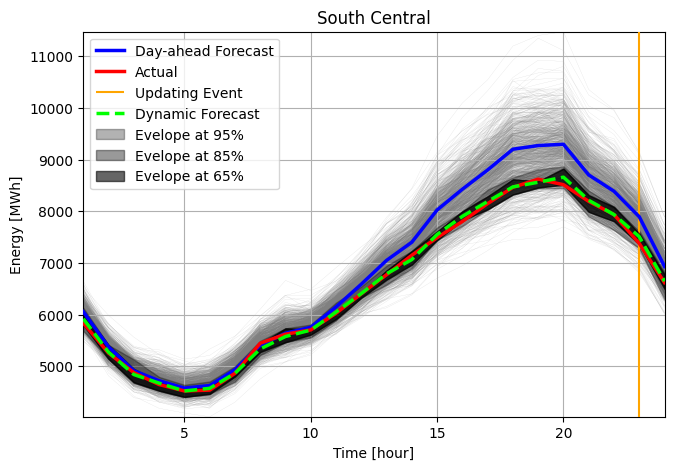

In [52]:
i_asset = 0

N_assets, _, N_gammas = opt_alphas_.shape
N_hours = y_ac_.shape[0]

x_ = np.linspace(1, N_hours, N_hours)

# Get Scenarios and actuals
y_ac_ = Sim_[i_source][0][:, i_asset]
y_fc_ = Sim_[i_source][1][:, i_asset]
Y_sc_ = Sim_[i_source][2][:, :, i_asset]
    
for i_hour in range(1, N_hours):
    
    # Rank data using only seen samples
    y_ac_prime_ = y_ac_[:i_hour]
    Y_sc_prime_ = Y_sc_[:i_hour, :]
            
    # Plot day-ahead forecasting envelop
    plt.figure(figsize = (7.5, 5))
    plt.title(y_names_[i_asset])
    plt.plot(x_, Y_sc_, color = 'gray', linewidth = .1, zorder = 1, alpha = .5)
    plt.plot(x_, y_fc_, color = 'b', linewidth = 2.5, zorder = 9, label = 'Day-ahead Forecast')
    plt.plot(x_, y_ac_, color = 'r', linewidth = 2.5, zorder = 9, label = 'Actual')
    plt.vlines(i_hour, Y_sc_.min(), Y_sc_.max(), color = 'orange', zorder = 5, label = 'Updating Event')
    
    plt.xlim(1, N_hours)
    plt.ylim(Y_sc_.min(), Y_sc_.max())
    
    f_mean_, _, _ = _functional_envelop_predictive(Y_sc_, d_rank_[::-1], opt_alphas_[i_asset, i_hour - 1, 0])
    plt.plot(x_, f_mean_, '--', color = 'lime', linewidth = 2.5, zorder = 9, label = 'Dynamic Forecast')
        
    for i_gamma in [0, 2, 6]:
        sigma = opt_sigmas_[i_asset, i_hour - 1, i_gamma]
        alpha = opt_alphas_[i_asset, i_hour - 1, i_gamma]
        print(i_gamma, gammas_[i_gamma], opt_alphas_[i_asset, i_hour - 1, i_gamma], 1000. - int(1000.*opt_alphas_[i_asset, i_hour - 1, i_gamma]))
            
        # Rank scenarios using modified band depth notion
        d_      = _exp_distance(y_ac_prime_, Y_sc_prime_, sigma)
        d_rank_ = np.argsort(d_)
        
        f_mean_, f_upper_, f_lower_ = _functional_envelop_predictive(Y_sc_, d_rank_[::-1], opt_alphas_[i_asset, i_hour - 1, i_gamma])
    
        plt.fill_between(x_, f_lower_, f_upper_, color = 'k', alpha = gammas_[i_gamma] + .25, zorder = i_gamma + 2, 
                         label = r'Evelope at {}%'.format(int(100.*(1. - gammas_[i_gamma]))))
    plt.ylabel('Energy [MWh]')
    plt.xlabel('Time [hour]')
    plt.legend()
    plt.grid()
    plt.show()

## Notes

In [6]:
def _dynamic_update(y_ac_, y_fc_, y_mu_, Y_sc_, i_hour):
    
    def __a(x_):
        return .915 - np.exp(-x_*0.8 - .9)
    
    y_ac_prime_ = y_ac_[:i_hour]
    y_fc_prime_ = y_fc_[:i_hour]
    y_mu_prime_ = y_mu_[:i_hour]
    Y_sc_prime_ = Y_sc_[:i_hour, :]
    #print(w_ac_prime_.shape, w_fc_prime_.shape, W_sc_prime_.shape)

    dist_      = _exp_distance(y_ac_prime_, Y_sc_prime_)
    dist_rank_ = np.argsort(dist_)

    print(_a(i_hour))

    f_upper_, f_lower_, f_mean_, Y_sc_prime_, d_prime_ = _functional_envelop(Y_sc_, dist_rank_[::-1], alpha = __a(i_hour))
    
    y_hat_ = Y_sc_ @ dist_

    return f_upper_, f_lower_, y_hat_

i_file   = 0
i_source = 2
i_hour   = 12

# Load Simulation
Sim_  = _load_all_datasets(files_[i_file])

y_ac_ = np.sum(Sim_[i_source][0], axis = -1)
y_fc_ = np.sum(Sim_[i_source][1], axis = -1)
Y_sc_ = np.sum(Sim_[i_source][2], axis = -1)
y_mu_ = np.mean(Y_sc_, axis = 1)
print(y_ac_.shape, y_fc_.shape, Y_sc_.shape, y_mu_.shape)




(24,) (24,) (24, 1000) (24,)


In [9]:
from ipywidgets import interact, interactive, fixed, interact_manual


def _dynamic_update(y_ac_, y_fc_, y_mu_, Y_sc_, i_hour):
    
    def __a(x):
        return .985 - np.exp(-x*0.25 - .9)
    
    y_ac_prime_ = y_ac_[:i_hour]
    y_fc_prime_ = y_fc_[:i_hour]
    y_mu_prime_ = y_mu_[:i_hour]
    Y_sc_prime_ = Y_sc_[:i_hour, :]
    #print(w_ac_prime_.shape, w_fc_prime_.shape, W_sc_prime_.shape)

    dist_      = _exp_distance(y_ac_prime_, Y_sc_prime_)
    dist_rank_ = np.argsort(dist_)

    print(__a(i_hour))

    f_upper_, f_lower_, f_mean_, Y_sc_prime_, d_prime_ = _functional_envelop(Y_sc_, dist_rank_[::-1], alpha = __a(i_hour))
    
    y_hat_ = (Y_sc_prime_ @ d_prime_)/d_prime_.sum()
    return f_upper_, f_lower_, y_hat_


def _dynamic_update_animation(i_hour):
    
    x_ = np.linspace(0, 23, 24)
    
    f_upper_, f_lower_, f_mean_ = _dynamic_update(y_ac_, y_fc_, y_mu_, Y_sc_, i_hour)

    plt.figure(figsize = (15, 10))
    plt.plot(Y_sc_, color = 'gray', linewidth = .5, zorder = 1.)
    plt.plot(y_fc_, color = 'yellow', linewidth = 2.5, zorder = 3.)
    plt.plot(y_ac_, color = 'red', marker = '+', linewidth = 2.5, zorder = 3.)
    plt.plot(f_mean_, color = 'lime', marker = '.', linewidth = 2.5, zorder = 3.)
    #plt.plot(f_lower_, color = 'k', linewidth = 1.5, zorder = 3.)
    #plt.plot(f_upper_, color = 'k', linewidth = 1.5, zorder = 3.)
    plt.fill_between(x_, f_lower_, f_upper_, color = 'k', zorder = 2., alpha = 0.85)
    plt.vlines(i_hour - 1, Y_sc_.min(), Y_sc_.max(), color = 'orange', zorder = 4.)
    plt.xlim(0, 23)
    plt.ylim(Y_sc_.min(), Y_sc_.max())
    plt.grid()
    plt.show()
    

i_file   = 0
i_source = 0

file = files_[i_file]
print(file)

# Load Simulation
Sim_  = _load_all_datasets(file)

y_ac_ = np.sum(Sim_[i_source][0], axis = -1)
y_fc_ = np.sum(Sim_[i_source][1], axis = -1)
Y_sc_ = np.sum(Sim_[i_source][2], axis = -1)
y_mu_ = np.mean(Y_sc_, axis = 1)
print(y_ac_.shape, y_fc_.shape, Y_sc_.shape, y_mu_.shape)
    
interact(_dynamic_update_animation, i_hour = (1, 24, 1))

/Users/Guille/Desktop/extreme_scenarios/data/SimDat_20180722
(24,) (24,) (24, 1000) (24,)


interactive(children=(IntSlider(value=12, description='i_hour', max=24, min=1), Output()), _dom_classes=('widg…

<function __main__._dynamic_update_animation(i_hour)>

0 422
0 422
1 332
2 262
3 208
4 165
5 132
6 106
7 86
8 71
9 58
10 49
11 41
12 36
13 31
14 28
15 25
16 23
17 21
18 20
19 19
20 18
21 18
22 17
23 17
24 17


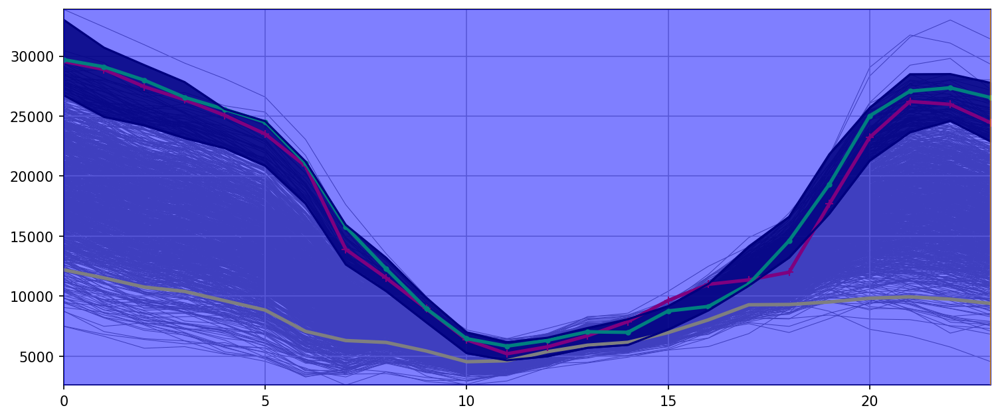

In [19]:
from matplotlib import animation

def _dynamic_update(y_ac_, y_fc_, y_mu_, Y_sc_, i_hour):
    
    def __a(x):
        return .985 - np.exp(-x*0.25 - .9)
    
    y_ac_prime_ = y_ac_[:i_hour]
    y_fc_prime_ = y_fc_[:i_hour]
    y_mu_prime_ = y_mu_[:i_hour]
    Y_sc_prime_ = Y_sc_[:i_hour, :]
    #print(y_ac_prime_.shape, y_fc_prime_.shape, Y_sc_prime_.shape)

    if i_hour == 0:
        mbd_, rank_ = _MBD(Y_sc_)
        f_upper_, f_lower_, f_mean_, Y_sc_prime_, dist_prime_ = _functional_envelop(Y_sc_, rank_[::-1], alpha = __a(i_hour))


    else:
        dist_ = _exp_distance(y_ac_prime_, Y_sc_prime_)
        rank_ = np.argsort(dist_)
        f_upper_, f_lower_, f_mean_, Y_sc_prime_, dist_prime_ = _functional_envelop(Y_sc_, rank_[::-1], alpha = __a(i_hour))
        f_mean_ = (Y_sc_ @ dist_)/dist_.sum()



    print(i_hour, 1000 - int(__a(i_hour)*1000))

    
    
    return f_upper_, f_lower_, f_mean_


def _dynamic_update_animation(i_hour):
    
    f_upper_, f_lower_, f_mean_ = _dynamic_update(y_ac_, y_fc_, y_mu_, Y_sc_, i_hour)

    x_ = np.linspace(0, 23, 24)

    plt.cla()
    plt.plot(Y_sc_, color = 'gray', linewidth = .5, zorder = 1.)
    plt.plot(y_fc_, color = 'yellow', linewidth = 2.5, zorder = 3.)
    plt.plot(y_ac_, color = 'red', marker = '+', linewidth = 2.5, zorder = 3.)
    plt.plot(f_mean_, color = 'lime', marker = '.', linewidth = 2.5, zorder = 3.)
    plt.plot(f_lower_, color = 'k', linewidth = 1.5, zorder = 3.)
    plt.plot(f_upper_, color = 'k', linewidth = 1.5, zorder = 3.)
    plt.fill_between(x_, f_lower_, f_upper_, color = 'k', zorder = 2., alpha = 0.85)
    plt.fill_between(x_, Y_sc_.max(), where=x_<=i_hour-1, color = 'b', alpha=.5, zorder = 4)
    
    plt.vlines(i_hour - 1, Y_sc_.min(), Y_sc_.max(), color = 'orange', zorder = 4.)
    plt.xlim(0, 23)
    plt.ylim(Y_sc_.min(), Y_sc_.max())
    plt.grid()
    
plt.rcParams["animation.html"] = "jshtml"
plt.rcParams['figure.dpi']     = 150  
plt.ioff()

# create a figure and axes
fig = plt.figure(figsize = (12, 5))

animation.FuncAnimation(fig, _dynamic_update_animation, frames = 25)

In [ ]:
# # Load csv avoiding errors in the headers
# def _read_csv_file(file_name):
#     with open(file_name) as _file:
#         rows_ = []
#         for row in csv.reader(_file, delimiter = ','):
#             row = np.asarray(row)[:, np.newaxis]
#             rows_.append(row)
#     #rows_.pop(0)
#     return np.concatenate(rows_, axis = 1).T
    
    
# # This is the path to data (stract inside Sim* files)
# path_to_data = r'/Users/Guille/Desktop/extreme_scenarios/data/'

# F_fc_     = _read_csv_file(path_to_data + r'/wind_day_ahead_forecast_2018.csv')
# names_fc_ = F_fc_[0, 3:]
# t_fc_     = F_fc_[1:, 2][17:-7]
# F_fc_     = F_fc_[1:, 3:].astype(np.float)
# F_fc_     = F_fc_[17:-7, :]
# print(names_fc_.shape, t_fc_.shape, F_fc_.shape)

# F_fc_prime_ = F_fc_.reshape(int(F_fc_.shape[0]/24), 24, F_fc_.shape[-1])
# t_fc_prime_ = t_fc_.reshape(F_fc_prime_.shape[0], F_fc_prime_.shape[1])
# F_fc_prime_ = np.swapaxes(F_fc_prime_, 0, 1)
# t_fc_prime_ = np.swapaxes(t_fc_prime_, 0, 1)
# print(F_fc_prime_.shape, names_fc_.shape, t_fc_prime_.shape)

# F_ac_     = _read_csv_file(path_to_data + r'/wind_actual_2018_5min.csv')
# names_ac_ = F_ac_[0, 1:]
# t_ac_     = F_ac_[1:, 0][24*12:]
# F_ac_     = F_ac_[1:, 1:].astype(np.float)
# F_ac_     = F_ac_[24*12:, :]
# print(names_ac_.shape, t_ac_.shape, F_ac_.shape)

# F_ac_prime_ = F_ac_.reshape(F_fc_.shape[0], int(F_ac_.shape[0]/F_fc_.shape[0]), F_fc_.shape[-1])
# F_ac_prime_ = F_ac_prime_.reshape(int(F_ac_prime_.shape[0]/24), 24*F_ac_prime_.shape[1], F_ac_prime_.shape[-1])
# t_ac_prime_ = t_ac_.reshape(F_ac_prime_.shape[0], F_ac_prime_.shape[1])
# F_ac_prime_ = np.swapaxes(F_ac_prime_, 0, 1)
# t_ac_prime_ = np.swapaxes(t_ac_prime_, 0, 1)
# index_      = np.argsort(names_ac_)
# names_ac_   = names_ac_[index_]
# F_ac_prime_ = F_ac_prime_[..., index_]
# print(F_ac_prime_.shape, names_ac_.shape, t_ac_prime_.shape)